In [1]:
'''
Date: 5/Apr/2023
Auther: Yike Xie
Content: Exclude patient 1_075: Figure 1 in dengue paper
'''

'\nDate: 5/Apr/2023\nAuther: Yike Xie\nContent: Exclude patient 1_075: Figure 1 in dengue paper\n'

In [2]:
# %matplotlib notebook
%config Completer.use_jedi = False

import os

import numpy as np
import pandas as pd

import anndata
import scanpy as sc

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection
from matplotlib import gridspec
import matplotlib as mpl
import seaborn as sns
from matplotlib import rcParams

from collections import defaultdict
import random
import itertools  

In [3]:
import sys
sys.path.append('/home/yike/phd/dengue/dengue_children/paper_figures/final/modules/') 
import YK_util, optimized_pair_comparison, functions_CCC_figure_fra_pair
from YK_util import *
from optimized_pair_comparison import *
from functions_CCC_figure_fra_pair import *

In [4]:
# load data
path = '/home/yike/phd/dengue/data/mergedata_luca_NKT_202206.h5ad'
adata = sc.read_h5ad(path)

adata_kid = subsetdata(adata)
adata_kid = normalizedata(adata_kid, log1p=True) # log1p = 2
adata_kid = removegenes(adata_kid)
adata_kid = adata_kid[(adata_kid.obs.cell_subtype_new != 'doublets') & 
                        (adata_kid.obs.cell_subtype_new != 'unknown')].copy()

sc.pp.filter_genes(adata_kid, min_cells=3)

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [5]:
#reorder some celltypes
reorg_data(adata_kid)

/home/yike/phd/dengue/dengue_children/paper_figures/final/modules/YK_util.py:172: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['cell_type_new'].cat.reorder_categories(group_order_primary, inplace=True)
/home/yike/phd/dengue/dengue_children/paper_figures/final/modules/YK_util.py:204: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['cell_subtype_new'].cat.reorder_categories(group_order_secondary, inplace=True)


In [6]:
#clustering
if False:
    cluster (adata_kid)

In [7]:
# exclude 1_075_01
adata_kid = adata_kid[~ (adata_kid.obs['ID'] == '1_075_01')]

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [8]:
#save path
save_figures = '/home/yike/phd/dengue/docs/nature_immunology_review/Answer_reviwers_nature_immunology1/'
save_tables = '/home/yike/phd/dengue/docs/nature_immunology_review/Answer_reviwers_nature_immunology1/'

In [9]:
# get cell types and cell subtypes
cell_types = adata_kid.obs['cell_type_new'].cat.categories.tolist()
cell_subtypes = adata_kid.obs['cell_subtype_new'].cat.categories.tolist()

In [10]:
# load cell type palette
ct_palette = load_ct_palette()
print([ct for ct in ct_palette.keys()])
sns.color_palette(ct_palette.values())

['B cells', 'Plasmablasts', 'T cells', 'NK cells', 'Monocytes', 'conventional DCs', 'plasmacytoid DCs', 'megakaryocytes']


[(0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8, 0.47058823529411764, 0.7372549019607844),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.984313725490196, 0.6862745098039216, 0.8941176470588236),
 (0.792156862745098, 0.5686274509803921, 0.3803921568627451),
 (0.5803921568627451, 0.5803921568627451, 0.5803921568627451)]

In [11]:
# load cell subtype palette
cst_palette = load_cst_palette()
print([cst for cst in cst_palette.keys()])
sns.color_palette(list(cst_palette.values())[:10])

['memory B cells', 'naive B cells', 'activated B cells', 'proliferating plasmablasts', 'non-proliferating plasmablasts', 'CD4+ naive T cells', 'CD4+ memory T cells', 'CD8+ naive T cells', 'CD8+ effector memory T cells', 'CD8+ exhausted T cells', 'Tregs', 'MAIT', 'signaling NK cells', 'cytotoxic NK cells', 'proliferating NK cells', 'classical monocytes', 'non-classical monocytes', 'intermediate monocytes', 'cDC1', 'cDC2', 'pDCs', 'megakaryocytes']


[(1.0, 0.0, 0.0),
 (0.7372549019607844, 0.5607843137254902, 0.5607843137254902),
 (0.5019607843137255, 0.0, 0.0),
 (1.0, 0.8941176470588236, 0.7686274509803922),
 (1.0, 0.5490196078431373, 0.0),
 (0.6901960784313725, 0.7686274509803922, 0.8705882352941177),
 (0.4392156862745098, 0.5019607843137255, 0.5647058823529412),
 (0.0, 0.0, 0.5019607843137255),
 (0.2549019607843137, 0.4117647058823529, 0.8823529411764706),
 (0.0, 0.7490196078431373, 1.0)]

In [12]:
sns.color_palette(list(cst_palette.values())[10:])

[(0.0, 1.0, 1.0),
 (0.37254901960784315, 0.6196078431372549, 0.6274509803921569),
 (0.5019607843137255, 0.0, 0.5019607843137255),
 (0.8666666666666667, 0.6274509803921569, 0.8666666666666667),
 (1.0, 0.0, 1.0),
 (0.5607843137254902, 0.7372549019607844, 0.5607843137254902),
 (0.5647058823529412, 0.9333333333333333, 0.5647058823529412),
 (0.0, 0.5019607843137255, 0.0),
 (1.0, 0.7529411764705882, 0.796078431372549),
 (1.0, 0.0784313725490196, 0.5764705882352941),
 (0.792156862745098, 0.5686274509803921, 0.3803921568627451),
 (0.5803921568627451, 0.5803921568627451, 0.5803921568627451)]

In [13]:
# APCs
mono_genes = [
    'S100A8', 'S100A9', 'S100A12', 'CD36', 'CTSB', 'ACSL1', 'FKBP5', 'RNASE2',
    'FCGR1A', 'FCGR2A', 'PRKCD', 'BTK', 'ITPR2', 
    'CD163', 
    'VCAN', 'CD63', 'SELL', 'ITGB2', 'ITGAM', 'CD99', 
    'STAT1', 'IRF1', 
    'IFIT1', 'ISG15', 'APOBEC3A', 'MARCKS', 'MX2', 'IFI6', 
    'HLA-DMA','HLA-DMB', 
    'HLA-DOA', 'HLA-DOB', 
    'HLA-DPA1', 'HLA-DPB1',
    'HLA-DQA1', 'HLA-DQB1',
    'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5', ]

cDC_genes = ['CD36','CYBB','MYD88','SYK','HMGB2', 'TIMP1','JAK2', 
    'SELL','ITGB2','ITGB7','ITGB1','CD164','MSN', 'EZR','LIMS1','TLN1',
    'IFITM3', 'STAT1', 'STAT3',
    'HLA-DMA','HLA-DMB', 
    'HLA-DOA', 'HLA-DOB', 
    'HLA-DPA1', 'HLA-DPB1',
    'HLA-DQA1', 'HLA-DQB1',
    'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5', ]

B_genes = [
    'PABPC1', 'EEF2','EIF4G2','HSPA5', 'HSP90AB1',
    'CSDE1',
    'EIF4B','BZW1', 'PCBP1', 'NCL',
    'IFITM3',
    'BTG2',
    'HLA-DMA','HLA-DMB', 
    'HLA-DOA', 'HLA-DOB', 
    'HLA-DPA1', 'HLA-DPB1',
    'HLA-DQA1', 'HLA-DQB1',
    'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5',
    'MT-CO2','MT-CO3','MT-ND2','MT-ND4L']

# effector cells
NK_genes = [
    'CAPN2','LCP1', 'ADD3',
    'PABPC1', 'PCBP1', 'CSDE1', 'HSPA5', 'HSP90AB1',
    'HLA-DRB1', 'HLA-DPA1', 'HLA-DPB1',  
    'CCL5', 'IL32','CD2','ITGB1', 'LAG3',
    'LY6E', 'ISG15', 'IFI6', 
    'KLRB1',]

T_genes = [
    'CTLA4', 'LAG3', 'TIGIT', 'HAVCR2', 'PDCD1', 
    'PTPRC', 'IL32',
    'LY6E', 'ISG15','IFI6','IFITM3',]

PB_genes = ['IGHA1', 'IGHA2', 'IGHG1', 'IGHG2', 'IGHG3', 'IGHG4', 
            'COPG1', 'SEC14L1', 'SEC23B', 'SEC31A', 'SEC62', 'EEF2',
            'EIF4G1', 'EIF4G2', 'ELL2', ]

genes = {
    'Monocytes': mono_genes,
    'B cells': B_genes,
    'Plasmablasts': PB_genes,
    'T cells': T_genes,
    'NK cells': NK_genes,
    'conventional DCs': cDC_genes,
}

In [14]:
def patients_scatter(df, IDs, colors, labels, title, path=False):
    fig, ax = plt.subplots()
    rcParams['figure.figsize']=(8,4)
    rcParams['font.size']= 16
    rcParams['pdf.fonttype'] = 42
    rcParams['figure.dpi'] = 300
    rcParams['font.sans-serif'] = "Arial"

    order = [
        'classical monocytes',
        'non-classical monocytes',
        'intermediate monocytes',

        'cytotoxic NK cells',
        'signaling NK cells',

        'non-proliferating plasmablasts',
        'proliferating plasmablasts',

        'naive B cells',
        'memory B cells',
        'activated B cells',

        'CD4+ naive T cells',
        'CD4+ memory T cells',
        'CD8+ naive T cells',
        'CD8+ effector memory T cells',
        'CD8+ exhausted T cells',
        'Tregs',
        'MAIT',

        'cDC1',
        'cDC2',

    #         'pDCs',
    #         'megakaryocytes'
    ]

#     sns.violinplot(data=df, x='cst', y='fra_ct', ax=ax, order=order, 
#                 palette=[cst_palette[i] for i in order], scale='width',
#                   inner=None, alpha=0.2, linewidth=1)
    PROPS = {
        'boxprops':{'edgecolor':'black'},
        'medianprops':{'color':'black'},
        'whiskerprops':{'color':'none'},
        'capprops':{'color':'none'}
    }
    
    sns.boxplot(data=df, x='cst', y='fra_ct', ax=ax, order=order, 
            palette=['lightgray'], linewidth=1, **PROPS) # cst_palette[i] for i in order

    for ID, color in zip(IDs, colors):
        df_temp = df[df['ID'].isin(ID)]
        sns.stripplot(data=df_temp, x='cst', y='fra_ct', ax=ax, order=order, size=5,
                      palette=[color], edgecolor='white', linewidth=1,
                     )
    lgs = []
#     lg1 = ax.scatter([],[], c=cst_palette['classical monocytes'], 
#                    marker='s', s=100)
    for color in colors:
        lgs.append(ax.scatter([],[], c=color, s=50, alpha=0.7))

#     handles = [(lg1, i) for i in lgs]
    ax.legend(lgs, labels, bbox_to_anchor=(1, 1), loc='upper left', title=title, borderpad=0.3)

    ax.set_xticklabels(order, rotation=90)
    ax.set_xlabel(None)
    ax.set_ylabel('Fraction of cells\nin cell type (%)')

    if path is not False:
        fig.savefig(path + f'Patients_scatter_{title}.png', bbox_inches='tight')
        fig.savefig(path + f'Patients_scatter_{title}.pdf', bbox_inches='tight')

### UMAP pregnant

In [150]:
# 1_002_01
temp = adata_kid.copy()
temp.obs['Pregnant'] = 'No'
temp.obs.loc[temp.obs['ID'] == '1_002_01', 'Pregnant'] = 'Yes'

<IPython.core.display.Javascript object>


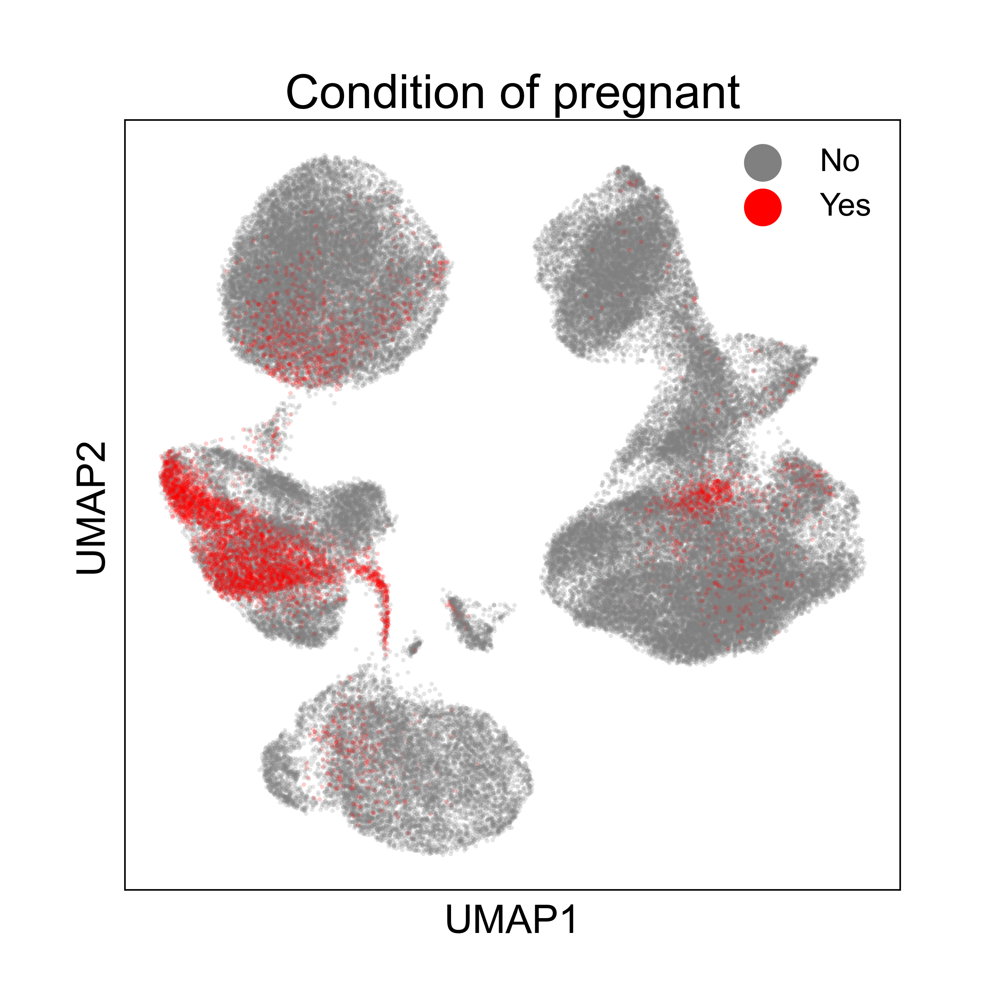

... storing 'Pregnant' as categorical
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


In [151]:
rcParams['figure.figsize']=(7,7)
rcParams['font.size']= 20
rcParams['pdf.fonttype'] = 42
rcParams['figure.dpi'] = 300
rcParams['font.sans-serif'] = "Arial"
    
fig, ax = plt.subplots()
sc.pl.umap(temp, color='Pregnant', palette = ['gray', 'red'], ax=ax, show=False, alpha=0.2,
           title = 'Condition of pregnant', size=20)
ax.legend(markerscale = 3, fontsize = 16, bbox_to_anchor=(1, 1), frameon = False)
fig.savefig(save_figures + 'UMAP_pregnant.png', bbox_inches='tight')
fig.savefig(save_figures + 'UMAP_pregnant.pdf', bbox_inches='tight')

In [51]:
df_frac = pd.read_csv('/home/yike/phd/dengue/docs/paper_draft/tabels/exclude_1_075_01/'
                      + 'df_frac.tsv', sep='\t')
df = df_frac[(df_frac['cst'] != 'PB/(PB+B)') & (df_frac['Condition'] != 'Healthy')]

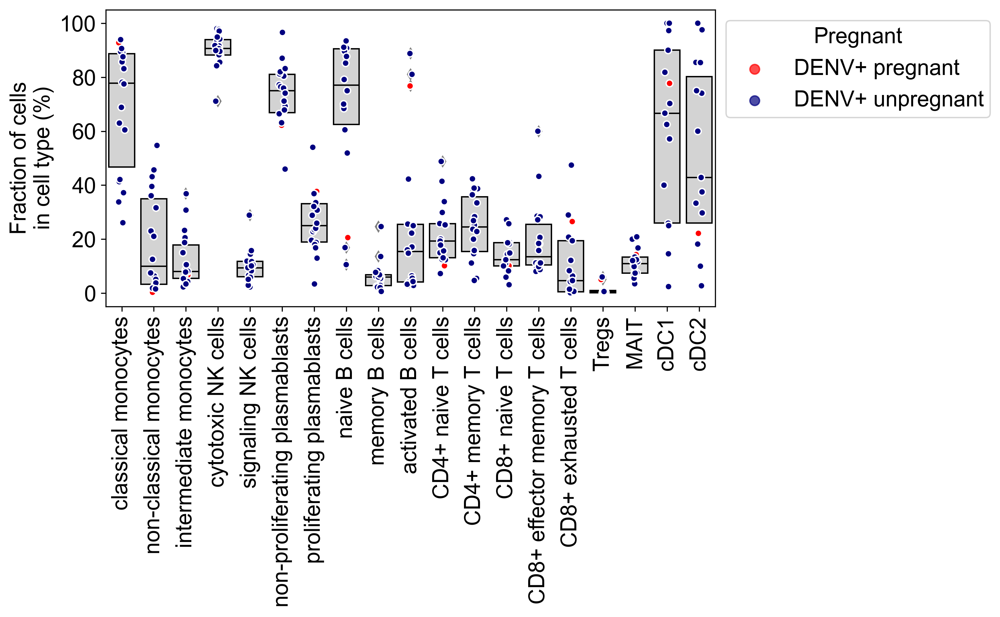

In [55]:
title = 'Pregnant'
path = save_figures
IDs = [['1_002_01'], [i for i in df['ID'].unique() if i not in ['1_002_01', '6_029_01']]] # remove '6_029_01'
colors = ['red', 'navy']
labels = ['DENV+ pregnant', 'DENV+ unpregnant']

patients_scatter(df, IDs, colors, labels, title, path=save_figures)

### UMAP teenagers

... storing 'Adolescent' as categorical
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


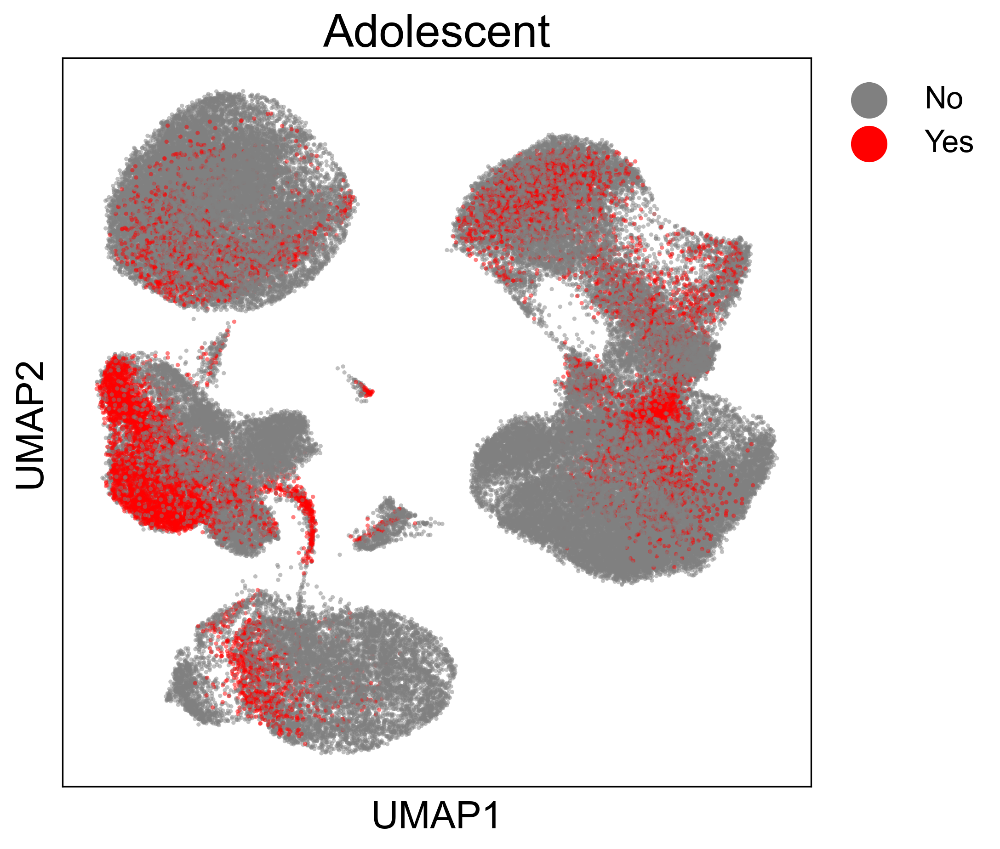

In [54]:
# SD 16, 17 years old
# 1_140_01, 1_144_01, 1_002_01

temp = adata_kid.copy()
temp.obs['Adolescent'] = 'No'
temp.obs.loc[temp.obs['ID'].isin(['1_140_01', '1_144_01', '1_002_01']), 'Adolescent'] = 'Yes'

# plot
rcParams['figure.figsize']=(7,7)
rcParams['font.size']= 20
rcParams['pdf.fonttype'] = 42
rcParams['figure.dpi'] = 300
rcParams['font.sans-serif'] = "Arial"
    
fig, ax = plt.subplots()
sc.pl.umap(temp, color='Adolescent', palette = ['gray', 'red'], ax=ax, show=False, alpha=0.5,
           title = 'Adolescent', size=20)
ax.legend(markerscale = 3, fontsize = 16, bbox_to_anchor=(1, 1), frameon = False)
fig.savefig(save_figures + 'UMAP_adolescent.png', bbox_inches='tight')
fig.savefig(save_figures + 'UMAP_adolescent.pdf', bbox_inches='tight')

In [146]:
# Age

IDs_1 = ['5_030_01', '5_193_01', '5_154_01', '6_025_01', '6_028_01'] # < 10
IDs_2 = ['1_019_01', '6_023_01', '5_041_01', '5_044_01', '6_020_01', 
         '5_089_01', '5_010_01', '5_130_01', '6_029_01'] # 10- 13
IDs_3 = ['6_001_01', '1_140_01', '1_144_01', '1_002_01', '1_113_01'] # 14 - 17
IDs_H = ['3_012_01', '3_037_01', '3_047_01', '3_074_01'] # 12, 11, 5, 8

temp = adata_kid.copy()
temp.obs['Age_cat'] = 'DENV-'
temp.obs.loc[temp.obs['ID'].isin(IDs_1), 'Age_cat'] = 'DENV+ <10'
temp.obs.loc[temp.obs['ID'].isin(IDs_2), 'Age_cat'] = 'DENV+ 10-13'
temp.obs.loc[temp.obs['ID'].isin(IDs_3), 'Age_cat'] = 'DENV+ 14-17'

temp.obs['Age_cat'] = temp.obs['Age_cat'].astype('category')
temp.obs['Age_cat'] = temp.obs['Age_cat'].cat.reorder_categories(['DENV-', 'DENV+ <10', 'DENV+ 10-13', 'DENV+ 14-17'])

<IPython.core.display.Javascript object>


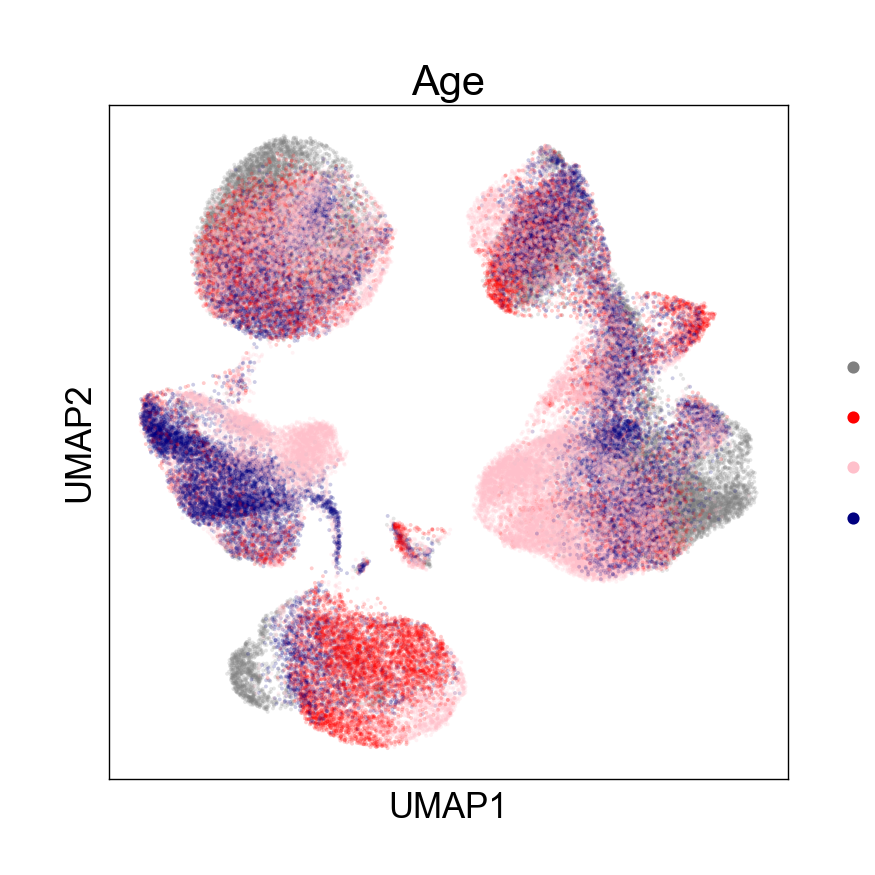

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


In [147]:
rcParams['figure.figsize']=(7,7)
rcParams['font.size']= 20
rcParams['pdf.fonttype'] = 42
rcParams['figure.dpi'] = 100
rcParams['font.sans-serif'] = "Arial"


fig, ax = plt.subplots()
sc.pl.umap(temp, color='Age_cat', ax=ax, show=False, alpha=0.2, 
           palette=['gray', 'red', 'pink', 'navy'],
           title = 'Age', size=20)
# ax.legend(markerscale = 3, fontsize = 16, bbox_to_anchor=(1, 1), frameon = False)
fig.savefig(save_figures + 'UMAP_age.png', bbox_inches='tight')
fig.savefig(save_figures + 'UMAP_age.pdf', bbox_inches='tight')

In [93]:
# Age 2

IDs_1 = ['5_030_01', '5_193_01', '5_154_01', '6_025_01', '6_028_01', '3_047_01', '3_074_01'] # < 10
IDs_2 = ['1_019_01', '6_023_01', '5_041_01', '5_044_01', '6_020_01', 
         '5_089_01', '5_010_01', '5_130_01', '6_029_01', '3_012_01', '3_037_01', ] # 10- 13
IDs_3 = ['6_001_01', '1_140_01', '1_144_01', '1_002_01', '1_113_01'] # 14 - 17
# IDs_H = [] # 12, 11, 5, 8

temp = adata_kid.copy()
temp.obs['Age_cat'] = 'Healthy'
temp.obs.loc[temp.obs['ID'].isin(IDs_1), 'Age_cat'] = '<10'
temp.obs.loc[temp.obs['ID'].isin(IDs_2), 'Age_cat'] = '10-13'
temp.obs.loc[temp.obs['ID'].isin(IDs_3), 'Age_cat'] = '14-17'

temp.obs['Age_cat'] = temp.obs['Age_cat'].astype('category')
temp.obs['Age_cat'] = temp.obs['Age_cat'].cat.reorder_categories(['<10', '10-13', '14-17'])

In [95]:
rcParams['figure.figsize']=(7,7)
rcParams['font.size']= 20
rcParams['pdf.fonttype'] = 42
rcParams['figure.dpi'] = 100
rcParams['font.sans-serif'] = "Arial"


fig, ax = plt.subplots()
sc.pl.umap(temp, color='Age_cat', ax=ax, show=False, alpha=0.5, 
           palette=['gray', 'pink', 'navy'],
           title = 'Age', size=20)
# ax.legend(markerscale = 3, fontsize = 16, bbox_to_anchor=(1, 1), frameon = False)
fig.savefig(save_figures + 'UMAP_age2.png', bbox_inches='tight')
fig.savefig(save_figures + 'UMAP_age2.pdf', bbox_inches='tight')

<IPython.core.display.Javascript object>

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<IPython.core.display.Javascript object>


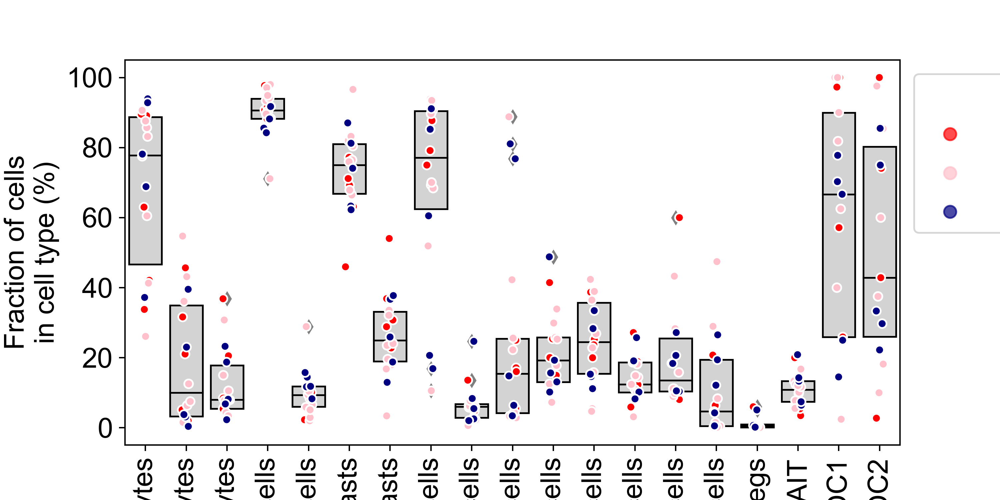

In [252]:
# < 10 '5_030_01', '5_193_01', '5_154_01', '6_025_01', '6_028_01'
# 10 - 13 (10, 11, 12, 13): '1_019_01', '6_023_01', '5_041_01', '5_044_01', '6_020_01', '5_089_01', '5_010_01', '5_130_01', '6_029_01'
# 14 - 17 (14, 15, 16, 17): '6_001_01', '1_140_01', '1_144_01', '1_002_01', '1_113_01'

title = 'Age'
path = save_figures
IDs_1 = ['5_030_01', '5_193_01', '5_154_01', '6_025_01', '6_028_01'] # < 10
IDs_2 = ['1_019_01', '6_023_01', '5_041_01', '5_044_01', '6_020_01', 
         '5_089_01', '5_010_01', '5_130_01', ] # 10- 13 # remove '6_029_01'
IDs_3 = ['6_001_01', '1_140_01', '1_144_01', '1_002_01', '1_113_01'] # 14 - 17
IDs = [IDs_1, IDs_2, IDs_3]
colors = ['red', 'pink', 'navy']
labels = ['DENV+ <10', 'DENV+ 10-13', 'DENV+ 14-17']

patients_scatter(df, IDs, colors, labels, title, path=save_figures)

## Hallmark analysis

In [63]:
def scatter_hallmarkers(DE_res, ct, genes, category, g1, g2, path=False):
    rcParams['figure.figsize']=(7,7)
    rcParams['font.size']= 20
    rcParams['pdf.fonttype'] = 42
    rcParams['figure.dpi'] = 300
    rcParams['font.sans-serif'] = "Arial"
    
    DE_ct = DE_res.loc[ct]
    fig, ax = plt.subplots()
    DE_ct['log2_fold_change'] = - DE_ct['log2_fold_change']
    ax.scatter(DE_ct['log2_fold_change'], -np.log10(DE_ct['pvalue_corrected']), c='gray', alpha=0.8,
               edgecolor='white', lw=1)

    DE_ct_gene = DE_ct[DE_ct['gene'].isin(genes)]
    yes = DE_ct_gene[abs(DE_ct_gene['log2_fold_change']) > 1]
    no =  DE_ct_gene[abs(DE_ct_gene['log2_fold_change']) <= 1]

    ax.scatter(yes['log2_fold_change'], -np.log10(yes['pvalue_corrected']), c='red', alpha=0.8,
               edgecolor='white', lw=1)
    ax.scatter(no['log2_fold_change'], -np.log10(no['pvalue_corrected']), c='navy', alpha=0.8,
               edgecolor='white', lw=1)

    for gene, x, y in zip(yes['gene'], yes['log2_fold_change'], -np.log10(yes['pvalue_corrected'])):
        ax.text(x-0.05, y, gene, fontsize=10, ha='right', va='bottom')

    ax.set_xlabel('Log2 fold change\n({} vs {})'.format(g2, g1))
    ax.set_ylabel('-Log10P')
    if ct == 'conventional DCs':
        name = 'cDCs'
    else:
        name = ct
    ax.set_title(f'{category} ({name})')

    labels = ['non-DEGs\n(SDp vs D)', 
              'Insig DEGs\n(SDp vs D)', 
              'Sig DEGs\n(SDp vs D)']
    handles = []
    for c in ['gray', 'navy', 'red', ]:
        handles.append(ax.scatter([], [], c=c, s=50))
    ax.legend(handles, labels, bbox_to_anchor=[1, 1], fontsize=10)

    ax.axvline(1, zorder=-5, ls='--', c='gray', alpha=0.5, lw=0.5)
    ax.axvline(-1, zorder=-5, ls='--', c='gray', alpha=0.5, lw=0.5)
    ax.axhline(-np.log10(0.05), zorder=-5, ls='--', c='gray', alpha=0.5, lw=0.5)

    if path is not False:
        fig.savefig(path + 'scatter_{}_{}.pdf'.format(category.replace(' ', '_'), name), bbox_inches='tight')
        fig.savefig(path + 'scatter_{}_{}.png'.format(category.replace(' ', '_'), name), bbox_inches='tight')
        
    return yes['gene'].tolist()

### Analysis between primary and secondary

In [230]:
import anndataks
ct_obs = 'cell_type_new'
adata_pm = adata_kid[adata_kid.obs['Dengue_exposure'] == 'Primary']
adata_sc = adata_kid[adata_kid.obs['Dengue_exposure'] == 'Secondary']
# 'Primary', 'Secondary'

results = {}
for cell_type in cell_types:
    pm_ct = adata_pm[adata_pm.obs[ct_obs] == cell_type]
    sc_ct = adata_sc[adata_sc.obs[ct_obs] == cell_type]
    
    results[cell_type] = anndataks.compare(sc_ct, pm_ct, log1p=2, mode='asymp')

res = pd.DataFrame([])
for cell_type in cell_types:
    results[cell_type][ct_obs] = [cell_type] * results[cell_type].shape[0]
    res = pd.concat([res, results[cell_type]] )
res.index.name = 'gene'

res.to_csv(save_tables + 'dengue_exposure_ks.tsv', sep='\t')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [231]:
from statsmodels.stats.multitest import multipletests

res = pd.read_csv(save_tables + 'dengue_exposure_ks.tsv', sep='\t')
res = res.set_index('cell_type_new')
res_adj = pd.DataFrame([])
for cell_type in cell_types:
    data_ct = res.loc[cell_type]
    adjust_pvalue = multipletests(data_ct['pvalue'], alpha=0.05, method='fdr_bh')[1] # pvals_corrected
    data_ct['pvalue_corrected'] = adjust_pvalue
    data_ct['cell_type'] = cell_type
    data_ct.reset_index(inplace=True)
    res_adj = pd.concat([res_adj, data_ct])
    
res_adj.set_index('cell_type_new').to_csv(save_tables + 'dengue_exposure_ks_adj.tsv', 
                                          sep='\t', index=False)
# avg1: secondary
# avg2 : primary

<ipython-input-231-e91db8c8c777>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ct['pvalue_corrected'] = adjust_pvalue
<ipython-input-231-e91db8c8c777>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ct['cell_type'] = cell_type
<ipython-input-231-e91db8c8c777>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/us

In [65]:
category = 'Dengue exposure'
g1 = 'Primary infection'
g2 = 'Secondary infection'
path = save_figures
DE_res = pd.read_csv(save_tables + 'dengue_exposure_ks_adj.tsv', 
                                          sep='\t', index_col='cell_type')

with open(save_tables + 'dengue_exposure_sig_DEGs.txt', 'w') as f:
    for ct, ct_genes in genes.items():
        ls = scatter_hallmarkers(DE_res, ct, ct_genes, category, g1, g2, path=save_figures)
        f.write('{}: {}\n'.format(ct, ','.join(ls)))

<IPython.core.display.Javascript object>

<ipython-input-63-278f6ea5ccfc>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DE_ct['log2_fold_change'] = - DE_ct['log2_fold_change']
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


<IPython.core.display.Javascript object>

In [371]:
pm_IDs = adata_kid[adata_kid.obs['Dengue_exposure'] == 'Primary'].obs['ID'].cat.categories.tolist()
sc_IDs = adata_kid[adata_kid.obs['Dengue_exposure'] == 'Secondary'].obs['ID'].cat.categories.tolist()

# add dengue exposure information
DE_fra = df_frac[df_frac['ID'].isin(pm_IDs + sc_IDs)]
DE_fra['Dengue exposure'] = 'Primary infection'
DE_fra.loc[DE_fra['ID'].isin(sc_IDs), 'Dengue exposure'] = 'Secondary infection'

<ipython-input-371-cd1e638a8e1c>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DE_fra['Dengue exposure'] = 'Primary infection'


In [373]:
def cst_abundance(p_PB, title, name, path=False):
    rcParams['figure.figsize']=(4,5)
    rcParams['font.size']= 20
    rcParams['pdf.fonttype'] = 42
    rcParams['font.sans-serif'] = "Arial"

    fig, ax = plt.subplots()
    PROPS = {
        'boxprops':{'edgecolor':'black'},
        'medianprops':{'color':'black'},
        'whiskerprops':{'color':'none'},
        'capprops':{'color':'none'}
    }
    sns.boxplot(data=p_PB, x='Dengue exposure', y='fra_ct', ax=ax, width=0.5,  
                **PROPS)
    sns.stripplot(data=p_PB, x='Dengue exposure', y='fra_ct', ax=ax, size=10, 
                  edgecolor='white', linewidth=2)

    ax.set_xlabel(None)
    ax.set_ylabel('Fraction of cells\nin cell type (%)')
    ax.set_title(title)
    ax.set_xticklabels(['Primary\ninfection', 'Secondary\ninfection'])

    if path is not False:
        fig.savefig(path + f'dengue_exposure_{name}_abundance.png', bbox_inches='tight', dpi=300)
        fig.savefig(path + f'dengue_exposure_{name}_abundance.pdf', bbox_inches='tight', dpi=300)

<IPython.core.display.Javascript object>


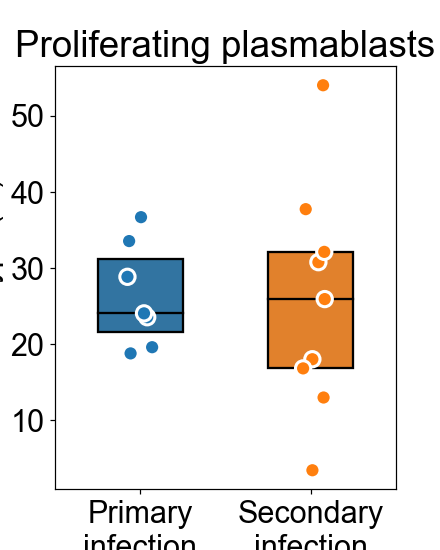

In [374]:
p_PB = DE_fra.set_index('cst').loc['proliferating plasmablasts']
title = 'Proliferating plasmablasts'
name = 'PB'

cst_abundance(p_PB, title, name, path=save_figures)

<IPython.core.display.Javascript object>


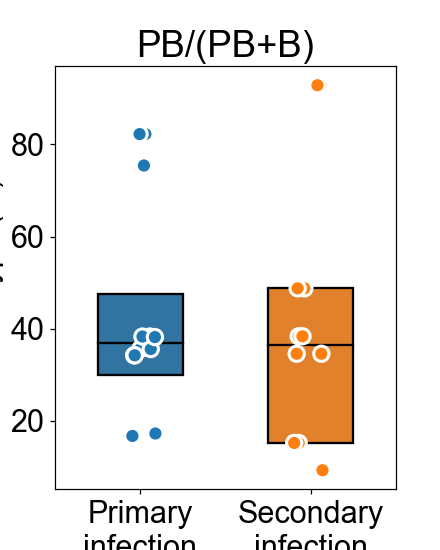

In [377]:
p_PB = DE_fra.set_index('cst').loc['PB/(PB+B)']
title = 'PB/(PB+B)'
name = 'PB_PB+B'

cst_abundance(p_PB, title, name, path=save_figures)

<IPython.core.display.Javascript object>


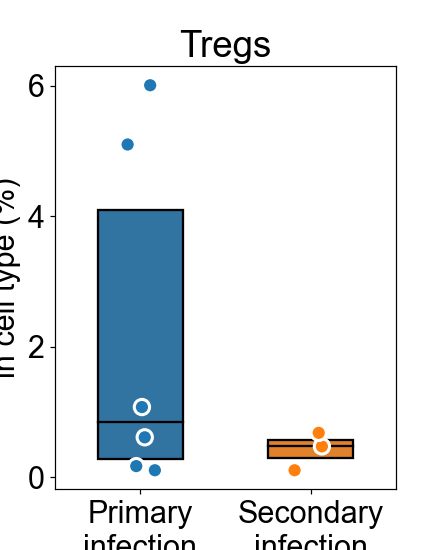

In [383]:
p_PB = DE_fra.set_index('cst').loc['Tregs']
title = 'Tregs'
name = 'Tregs'

cst_abundance(p_PB, title, name, path=save_figures)

<IPython.core.display.Javascript object>


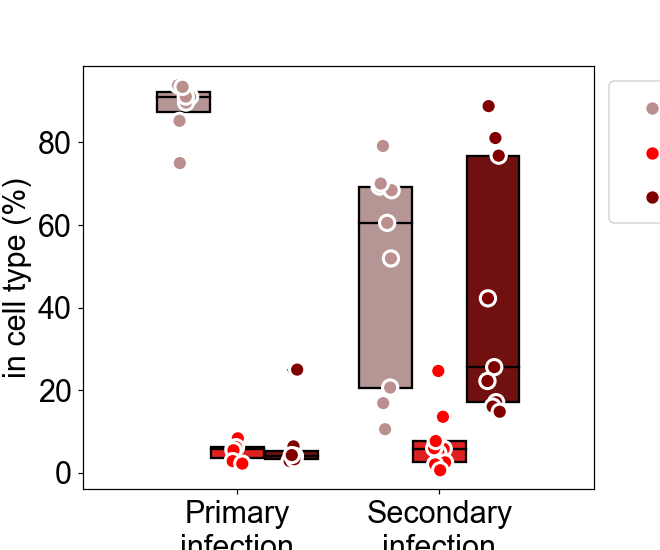

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


In [410]:
# B cells
B_csts = [
        'naive B cells',
        'memory B cells',
        'activated B cells',
]
path = save_figures
name = 'B_cells'

p_PB = DE_fra[DE_fra['cst'].isin(B_csts)]

rcParams['figure.figsize']=(6,5)
rcParams['font.size']= 20
rcParams['pdf.fonttype'] = 42
rcParams['font.sans-serif'] = "Arial"

fig, ax = plt.subplots()
PROPS = {
    'boxprops':{'edgecolor':'black'},
    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'none'},
    'capprops':{'color':'none'}
}
sns.boxplot(data=p_PB, x='Dengue exposure', y='fra_ct', ax=ax, width=0.8, hue='cst',
            hue_order=B_csts, palette=[cst_palette[i] for i in B_csts],
            **PROPS)
sns.stripplot(data=p_PB, x='Dengue exposure', y='fra_ct', ax=ax, size=10, hue='cst',
              hue_order=B_csts, palette=[cst_palette[i] for i in B_csts],
              edgecolor='white', linewidth=2, dodge=True)

ax.set_xlabel(None)
ax.set_ylabel('Fraction of cells\nin cell type (%)')
ax.set_xticklabels(['Primary\ninfection', 'Secondary\ninfection'])

ax.get_legend().remove()
handles = [ax.scatter([], [], s=50, c=c) for c in [cst_palette[i] for i in B_csts]]
ax.legend(handles, [i.replace(' cells', '') for i in B_csts], bbox_to_anchor=[1,1])

fig.savefig(path + f'dengue_exposure_{name}_abundance.png', bbox_inches='tight', dpi=300)
fig.savefig(path + f'dengue_exposure_{name}_abundance.pdf', bbox_inches='tight', dpi=300)

#### primary vs secondary cell abundance

In [256]:
pm_IDs = [i for i in adata_kid[adata_kid.obs['Dengue_exposure'] == 'Primary'].obs['ID'].cat.categories.tolist()
         if i != '6_029_01']
sc_IDs = [i for i in adata_kid[adata_kid.obs['Dengue_exposure'] == 'Secondary'].obs['ID'].cat.categories.tolist()
         if i != '6_029_01']

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [277]:
# add dengue exposure information
DE_fra2 = df_frac[df_frac['ID'].isin(pm_IDs + sc_IDs)]
DE_fra2['Dengue exposure'] = 'Primary infection'
DE_fra2.loc[DE_fra2['ID'].isin(sc_IDs), 'Dengue exposure'] = 'Secondary infection'
DE_fra2['Category'] = DE_fra2['Condition'] + ', ' + DE_fra2['Dengue exposure']

<ipython-input-277-dd5ce5817bc6>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DE_fra2['Dengue exposure'] = 'Primary infection'
<ipython-input-277-dd5ce5817bc6>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DE_fra2['Category'] = DE_fra2['Condition'] + ', ' + DE_fra2['Dengue exposure']


<IPython.core.display.Javascript object>


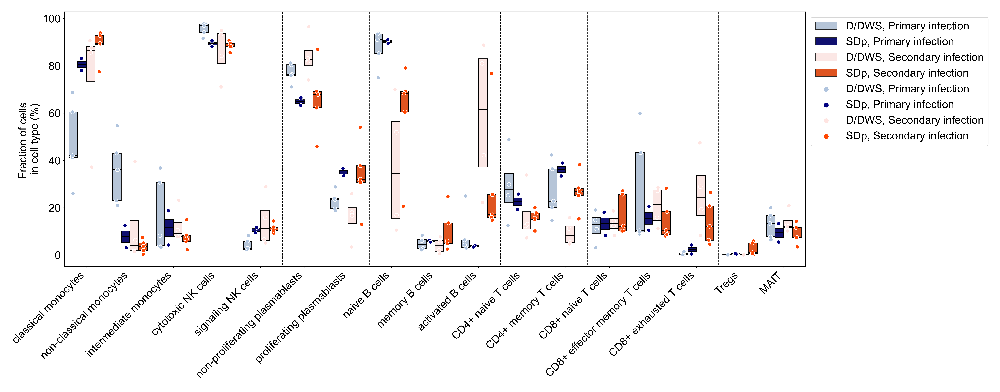

In [338]:
# def cell_abundance(df, cst_order, path, filetype, cds_n=3):
df = DE_fra2
cst_order = ['classical monocytes', 'non-classical monocytes', 'intermediate monocytes',
             'cytotoxic NK cells', 'signaling NK cells',
             'non-proliferating plasmablasts', 'proliferating plasmablasts', 
             'naive B cells', 'memory B cells', 'activated B cells', 
             'CD4+ naive T cells',
             'CD4+ memory T cells',
             'CD8+ naive T cells',
             'CD8+ effector memory T cells',
             'CD8+ exhausted T cells',
             'Tregs',
             'MAIT',]
hue_order = ['D/DWS, Primary infection', 
             'SDp, Primary infection',
             'D/DWS, Secondary infection',
             'SDp, Secondary infection', ]
path = save_figures
filetype = '.pdf'

rcParams['font.size']= 20
rcParams['pdf.fonttype'] = 42
rcParams['figure.dpi'] = 300
rcParams['font.sans-serif'] = "Arial"

fig, ax = plt.subplots(figsize=[len(cst_order)*1.5, 10])
# cmap = sns.color_palette('Set2', 4)
cmap = [
    'lightsteelblue',
    'navy',
    'mistyrose',
    'orangered'
]

PROPS = {
    'boxprops':{'edgecolor':'black'},
    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'none'},
    'capprops':{'color':'none'}
}

df_show = df[df['cst'].isin(cst_order)]
df_show = df_show.set_index('cst').loc[cst_order].reset_index()

sns.boxplot(data = df_show, 
            x = 'cst', y = 'fra_ct', hue='Category', 
            hue_order=hue_order, 
            palette=cmap, width=0.8, ax=ax, showfliers=False, **PROPS)
sns.stripplot(data = df_show, 
              x = 'cst', y = 'fra_ct', hue='Category', 
              hue_order=hue_order, 
              palette=cmap, s=7, ax=ax, edgecolor='white', linewidth=1, dodge=True)

ax.legend(bbox_to_anchor=(1, 1))
ax.set_ylabel('Fraction of cells \nin cell type (%)')
ax.set_xlabel(None)
#     ax.set_yscale('log')
labels = [x.get_text() for x in ax.get_xticklabels()]
ax.set_xticklabels(labels, rotation=45, ha='right')
for x in [0.5 + i for i in range(len(cst_order) - 1)]:
    ax.axvline(x, ls='--', c='k', lw=0.5)
fig.tight_layout()

if filetype is not False:
    name = 'cell_abundance' + filetype
    fig.savefig(os.path.join(path, name), bbox_inches='tight')

### Analysis between VHCs and non-VHCs

In [347]:
ct_obs = 'cell_type_new'
adata_pm = adata_kid[(adata_kid.obs['DENV_reads'] == 0) & 
                     (adata_kid.obs['Condition'] != 'Healthy')]
adata_sc = adata_kid[(adata_kid.obs['DENV_reads'] != 0) & 
                     (adata_kid.obs['Condition'] != 'Healthy')]
# 'Primary', 'Secondary'

results = {}
for cell_type in cell_types:
    pm_ct = adata_pm[adata_pm.obs[ct_obs] == cell_type]
    sc_ct = adata_sc[adata_sc.obs[ct_obs] == cell_type]
    if (pm_ct.obs.shape[0] == 0) or (sc_ct.obs.shape[0] == 0):
        continue
    
    results[cell_type] = anndataks.compare(sc_ct, pm_ct, log1p=2, mode='asymp')

res = pd.DataFrame([])
for cell_type in results.keys():
    results[cell_type][ct_obs] = [cell_type] * results[cell_type].shape[0]
    res = pd.concat([res, results[cell_type]] )
res.index.name = 'gene'

res.to_csv(save_tables + 'VHCs_ks.tsv', sep='\t')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [348]:
from statsmodels.stats.multitest import multipletests

res = pd.read_csv(save_tables + 'VHCs_ks.tsv', sep='\t')
res = res.set_index('cell_type_new')
res_adj = pd.DataFrame([])
for cell_type in results.keys():
    data_ct = res.loc[cell_type]
    adjust_pvalue = multipletests(data_ct['pvalue'], alpha=0.05, method='fdr_bh')[1] # pvals_corrected
    data_ct['pvalue_corrected'] = adjust_pvalue
    data_ct['cell_type'] = cell_type
    data_ct.reset_index(inplace=True)
    res_adj = pd.concat([res_adj, data_ct])
    
res_adj.set_index('cell_type_new').to_csv(save_tables + 'VHCs_ks_adj.tsv', 
                                          sep='\t', index=False)
# avg1: VHCs
# avg2 : bystanders

<ipython-input-348-1627b12f4a04>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ct['pvalue_corrected'] = adjust_pvalue
<ipython-input-348-1627b12f4a04>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ct['cell_type'] = cell_type
<ipython-input-348-1627b12f4a04>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/us

<IPython.core.display.Javascript object>


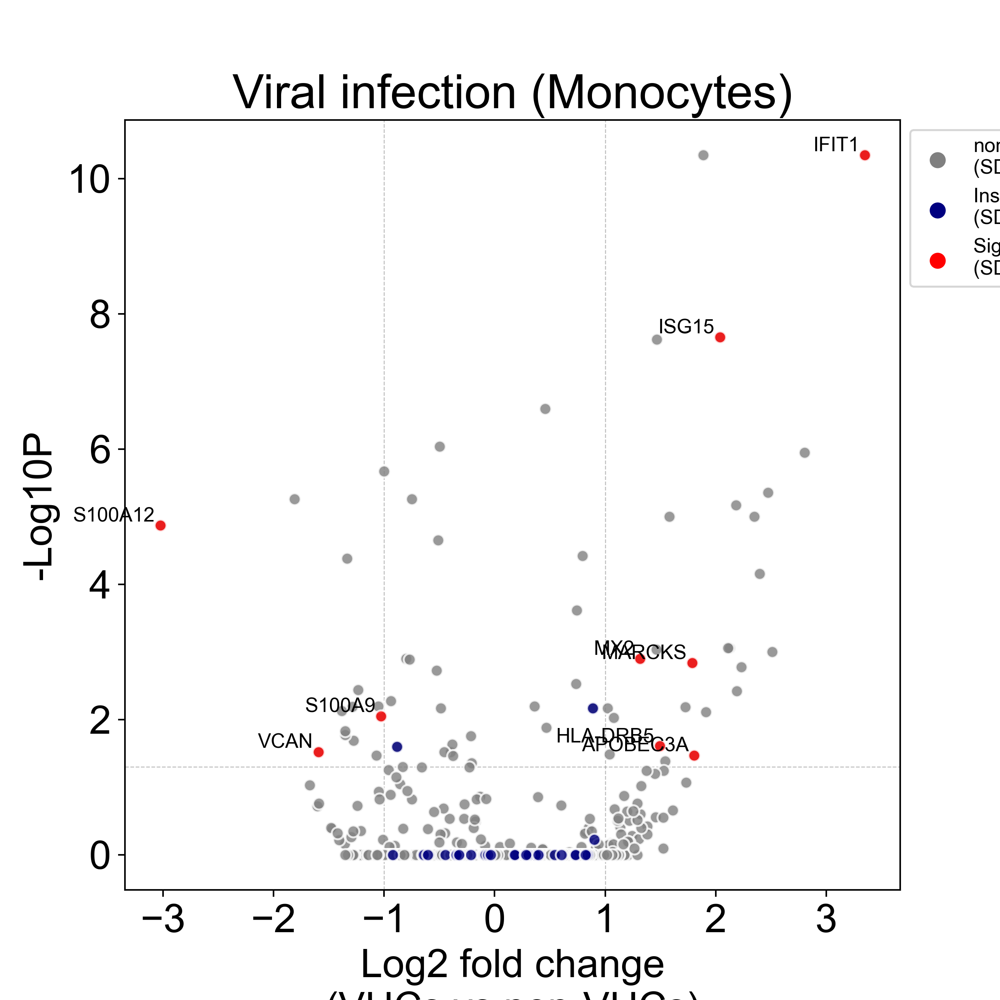

<ipython-input-63-278f6ea5ccfc>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DE_ct['log2_fold_change'] = - DE_ct['log2_fold_change']


<IPython.core.display.Javascript object>


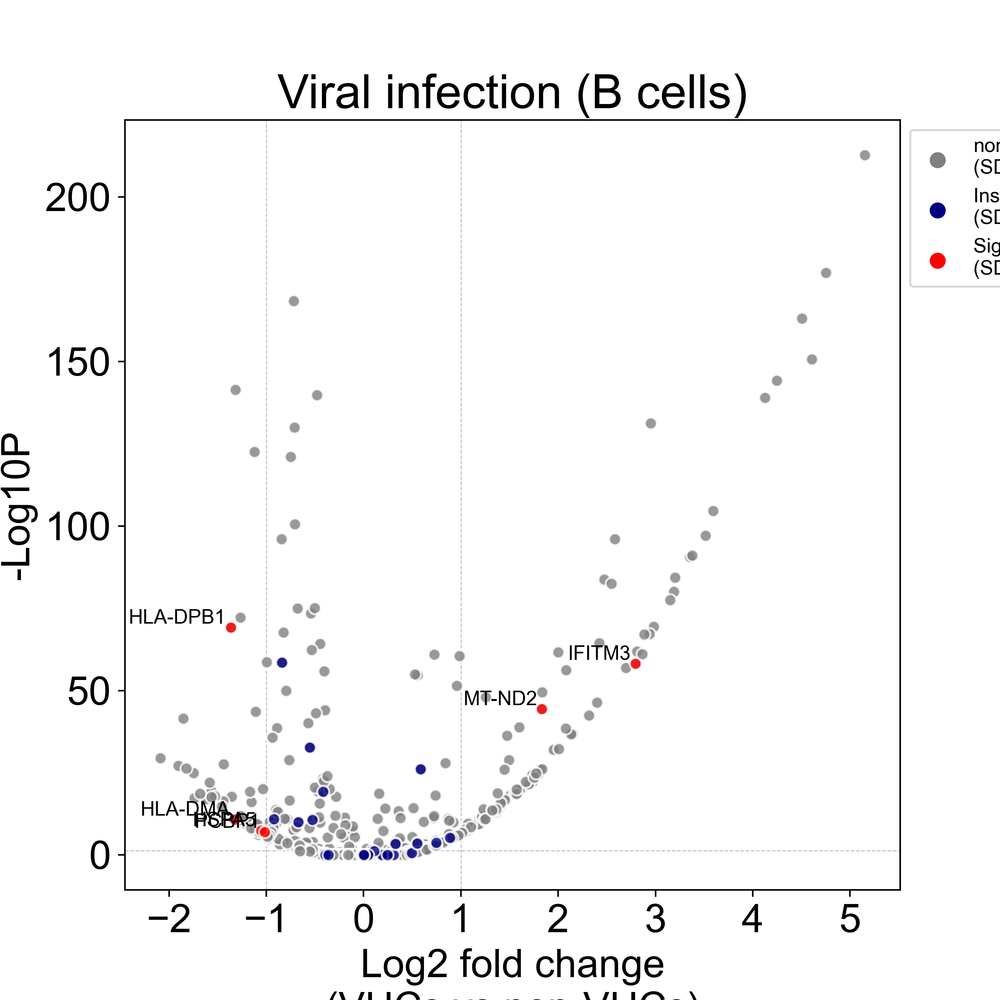

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


<IPython.core.display.Javascript object>


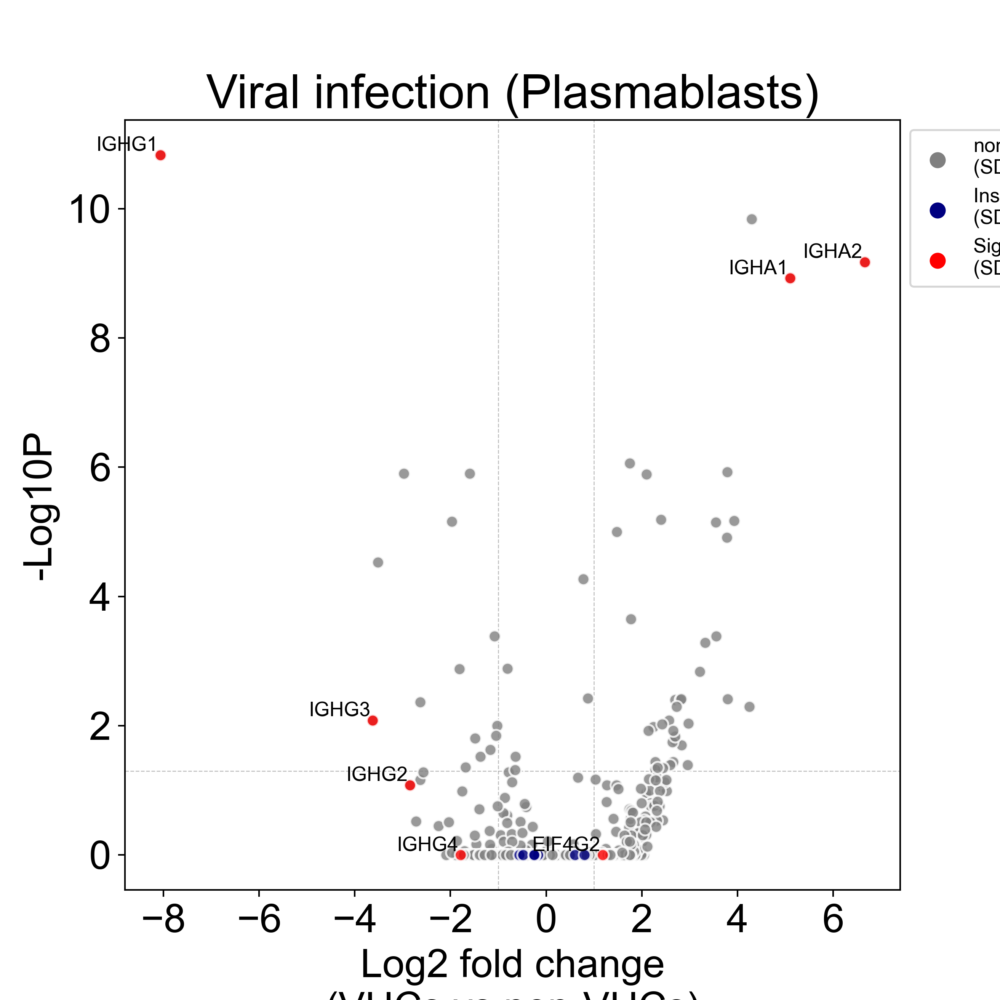

<IPython.core.display.Javascript object>


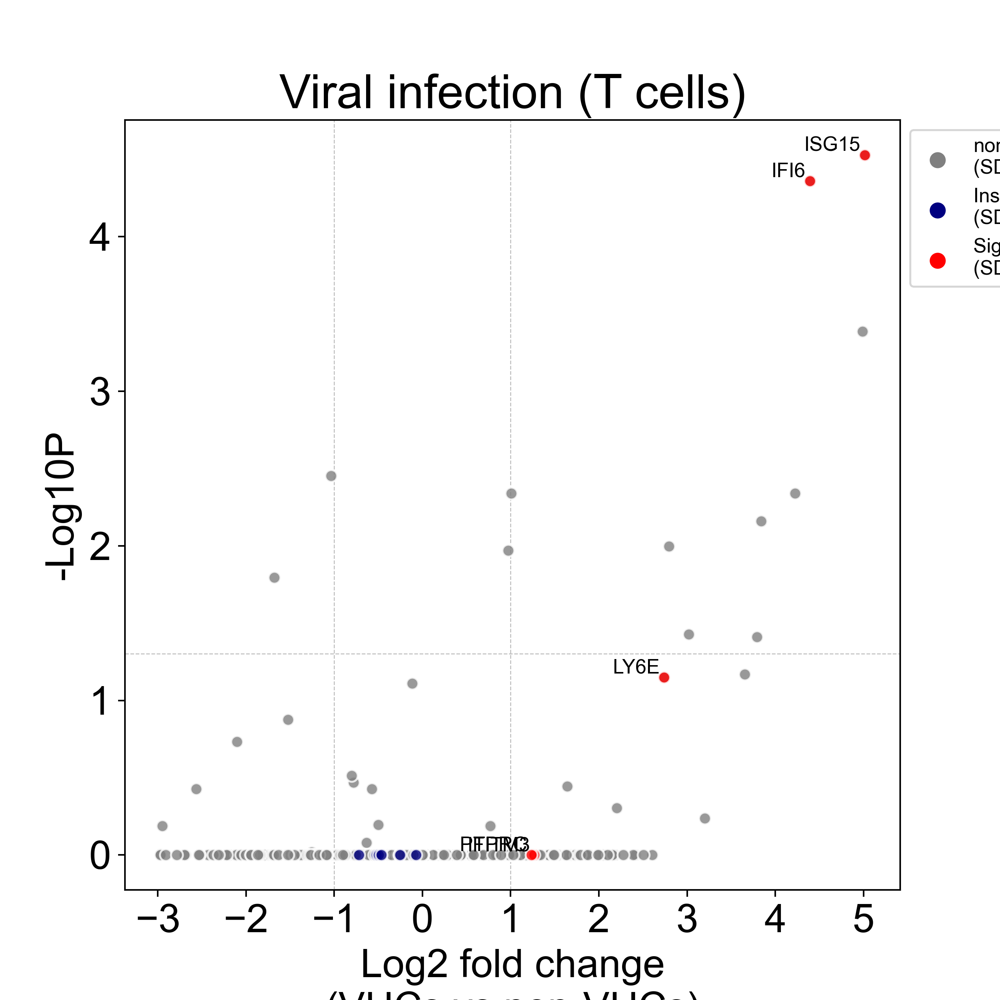

<IPython.core.display.Javascript object>


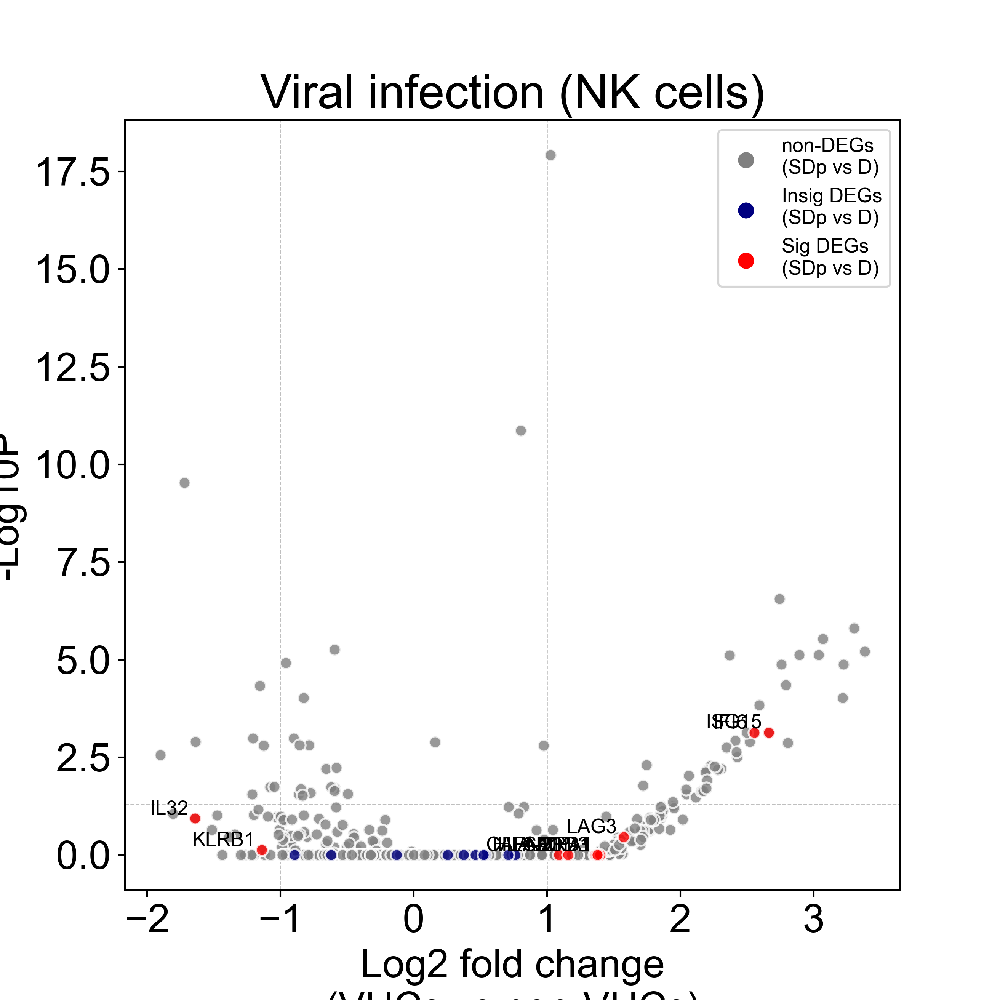

<IPython.core.display.Javascript object>


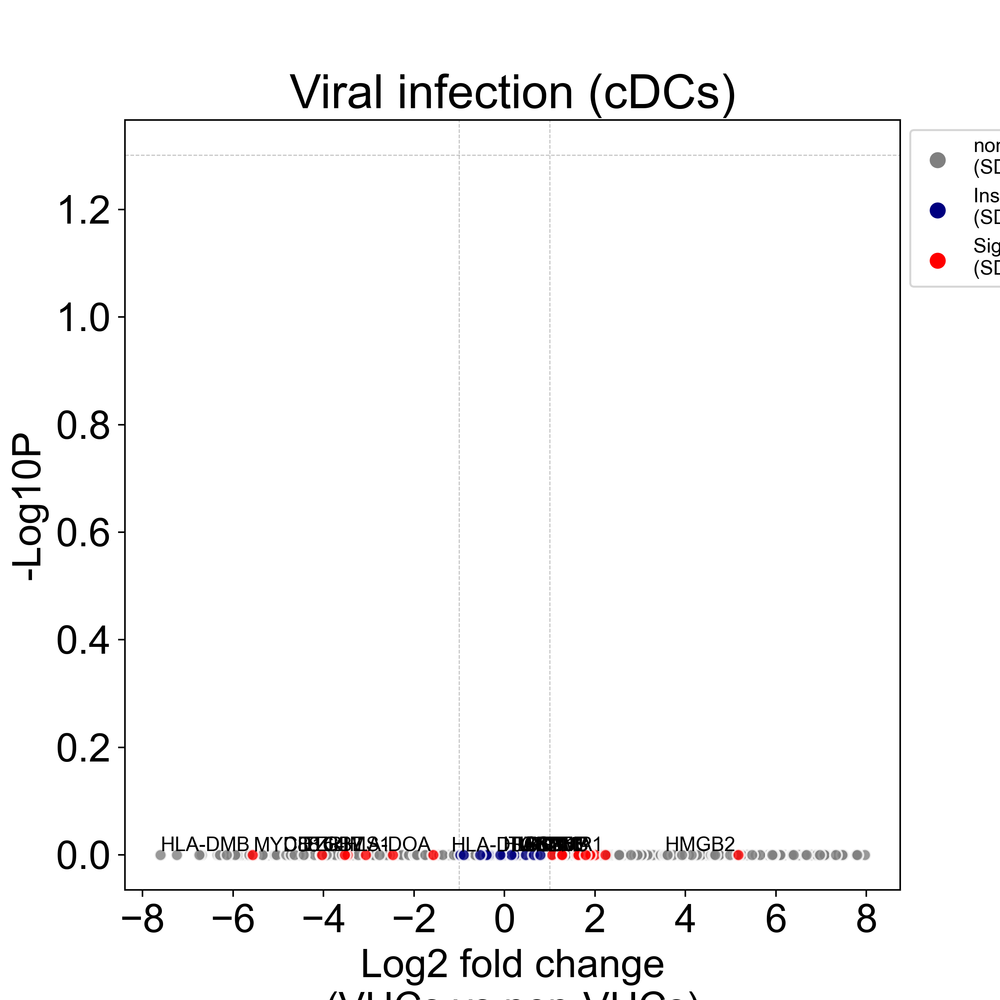

In [349]:
category = 'Viral infection'
g1 = 'non-VHCs'
g2 = 'VHCs'
path = save_figures
DE_res = pd.read_csv(save_tables + 'VHCs_ks_adj.tsv', 
                                          sep='\t', index_col='cell_type')

with open(save_tables + 'viral_infection_sig_DEGs.txt', 'w') as f:
    for ct, ct_genes in genes.items():
        ls = scatter_hallmarkers(DE_res, ct, ct_genes, category, g1, g2, path=save_figures)
        f.write('{}: {}\n'.format(ct, ','.join(ls)))

In [413]:
'''Are there differences in the expression of genes involved in 
   antigen processing, cathepsins, aminopeptidases, lysosome function 
   associated transcripts in VHCs compared to bystander cells?'''

'Are there differences in the expression of genes involved in \n   antigen processing, cathepsins, aminopeptidases, lysosome function \n   associated transcripts in VHCs compared to bystander cells?'

### remove 8th patient in cytokine and normalise cytokine concentration in the heatmap

In [13]:
# data
res = pd.read_excel('/home/yike/phd/dengue/data/Luca_cyto_exp.xlsx', sheet_name='results', skiprows=[0])
# exclude VCAM1
cols = res.columns.tolist()
cols.remove('VCAM1')
res = res[cols]
# exclude patient 1_075_01
res = res[~ (res['ID'] == '1_075_01')]
res = res.set_index(['Condition', 'ID'])
res = res.replace(['<0.03', '<3.00', '<4.80'], 0)
res = res.astype('float').loc[['H', 'D', 'DWS', 'SD']]

# Whitney-man U test
pair = pd.read_csv('/home/yike/phd/dengue/docs/paper_draft/tabels/exclude_1_075_01/cytokines/cyto_pair.tsv', 
            sep='\t', index_col='gene')

In [14]:
pvalue='pvalue_U'
idx_ks = pair[pair[pvalue] < 0.05].sort_values(['med_pair', 'avg_SD'], ascending=False).index
idx_not = [idx for idx in pair.index if idx not in idx_ks]
idx_ks_rest = pair.loc[idx_not].sort_values(['med_pair', 'avg_SD'], ascending=False).index
new_idx = idx_ks.tolist() + idx_ks_rest.tolist()
res = res[new_idx]

In [15]:
pm_IDs = adata_kid[adata_kid.obs['Dengue_exposure'] == 'Primary'].obs['ID'].cat.categories.tolist()
sc_IDs = adata_kid[adata_kid.obs['Dengue_exposure'] == 'Secondary'].obs['ID'].cat.categories.tolist()

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [17]:
cyto_DE = res.reset_index()[res.reset_index()['ID'].isin(pm_IDs + sc_IDs)]
cyto_DE['Dengue exposure'] = 'Primary infection'
cyto_DE.loc[cyto_DE['ID'].isin(sc_IDs), 'Dengue exposure'] = 'Secondary infection'

In [32]:
cyto_DE_U = cyto_DE.drop(['Condition', 'ID'], axis=1).reset_index('Dengue exposure')

from scipy.stats import ttest_ind, ks_2samp, mannwhitneyu
stats_u = []
pvalue_u = []

for gene in cyto_DE_U.columns:
    if sum(res.loc['D'][gene].tolist()) + sum(res.loc['SD'][gene].tolist()) == 0:
        s, p = 'N/A', 1
        stats_u.append(s)
        pvalue_u.append(p)
        continue
        
    s, p = mannwhitneyu(cyto_DE_U.loc['Secondary infection'][gene].tolist(), 
                        cyto_DE_U.loc['Primary infection'][gene].tolist(), 
                        alternative='two-sided',)
    stats_u.append(s)
    pvalue_u.append(p)

cyto_DE_U.loc['statistic_U'] = stats_u
cyto_DE_U.loc['pvalue_U'] = pvalue_u

In [48]:
from scipy.stats import gaussian_kde
def cyto_violin_new(res, cyto):
    rcParams['font.size'] = 18
    rcParams['pdf.fonttype'] = 42
    rcParams['font.sans-serif'] = "Arial"
    rcParams['figure.dpi'] = 300
    
    res_c = res[cyto]
    
    n = len(str(res_c.max()).split('.')[0]) - 1
    lim = ((res_c.max() // (10**n)) + 1) * 10 ** n

    fig, ax = plt.subplots(figsize=(3, 4))
    palette = sns.color_palette('tab10', 2)

    for i, cd, cl in zip(range(2), ['Primary infection', 'Secondary infection'], palette):
        x = res_c.loc[cd].tolist()
        if max(x) == min(x):
            x = np.zeros(len(x))
            x[0] = 0.01
        # This is the key line
        xfit = np.linspace(0, lim, 1000); 
        yfit = gaussian_kde(x)(xfit); 
        yfit *= 0.4 / yfit.max()
        ax.fill_betweenx(xfit, -yfit + i, yfit + i, facecolor=cl, edgecolor='k', alpha=1, lw=2)
        ax.scatter([i] * len(x), x, color='k', alpha=0.6, edgecolor=None, s=15)

    ax.set_xticks([0, 1])
    ax.set_xticklabels(['Primary\ninfection', 'Secondary\ninfection'])

    yticks = ax.get_yticks().tolist()
    unit = len(str(int(-yticks[0]))) - 1
    yticklabels = [str(int(i/10**unit)) + '×$10^{}$'.format(str(unit)) for i in yticks]
    ax.set_yticks(yticks)
    ax.set_yticklabels(yticklabels)

    ax.set_ylabel('Concentration (pg/mL)')
    
    ax.set_title(cyto)
    
    return {'fig': fig, 'ax': ax}

In [53]:
sig_genes = cyto_DE_U.columns[cyto_DE_U.loc['pvalue_U'] < 0.05].tolist()
for gene in sig_genes:
    fig = cyto_violin_new(cyto_DE_U, gene)['fig']
    fig.savefig(save_figures + f'{gene}_cyto.png', bbox_inches='tight')
    fig.savefig(save_figures + f'{gene}_cyto.pdf', bbox_inches='tight')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Analysis between VHCs in SDp and D

In [110]:
ct_obs = 'cell_type_new'
adata_pm = adata_kid[(adata_kid.obs['DENV_reads'] != 0) & 
                     (adata_kid.obs['Condition'] == 'dengue')]
adata_sc = adata_kid[(adata_kid.obs['DENV_reads'] != 0) & 
                     (adata_kid.obs['Condition'] == 'S_dengue')]
# 'Primary', 'Secondary'

results = {}
for cell_type in cell_types:
    pm_ct = adata_pm[adata_pm.obs[ct_obs] == cell_type]
    sc_ct = adata_sc[adata_sc.obs[ct_obs] == cell_type]
    if (pm_ct.obs.shape[0] == 0) or (sc_ct.obs.shape[0] == 0):
        continue
    
    results[cell_type] = anndataks.compare(sc_ct, pm_ct, log1p=2, mode='asymp')

res = pd.DataFrame([])
for cell_type in results.keys():
    results[cell_type][ct_obs] = [cell_type] * results[cell_type].shape[0]
    res = pd.concat([res, results[cell_type]] )
res.index.name = 'gene'

res.to_csv(save_tables + 'VHCs_SD_D_ks.tsv', sep='\t')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [111]:
from statsmodels.stats.multitest import multipletests

res = pd.read_csv(save_tables + 'VHCs_SD_D_ks.tsv', sep='\t')
res = res.set_index('cell_type_new')
res_adj = pd.DataFrame([])
for cell_type in results.keys():
    data_ct = res.loc[cell_type]
    adjust_pvalue = multipletests(data_ct['pvalue'], alpha=0.05, method='fdr_bh')[1] # pvals_corrected
    data_ct['pvalue_corrected'] = adjust_pvalue
    data_ct['cell_type'] = cell_type
    data_ct.reset_index(inplace=True)
    res_adj = pd.concat([res_adj, data_ct])
    
res_adj.set_index('cell_type_new').to_csv(save_tables + 'VHCs_SD_D_ks_adj.tsv', 
                                          sep='\t', index=False)
# avg1: VHCs
# avg2 : bystanders

<ipython-input-111-5b3a41b2de8c>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ct['pvalue_corrected'] = adjust_pvalue
<ipython-input-111-5b3a41b2de8c>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_ct['cell_type'] = cell_type


### paiwise comparison t-test

In [227]:
SD_IDs = adata_kid[adata_kid.obs['Condition'] == 'S_dengue'].obs['ID'].unique().tolist()
D_IDs = adata_kid[adata_kid.obs['Condition'] == 'dengue'].obs['ID'].unique().tolist()

In [247]:
# t-test
from scipy.stats import ttest_ind
t_res = pd.DataFrame()
for ct in cell_types:
    adata_ct = adata_kid[adata_kid.obs['cell_type_new'] == ct]

    gs_SD = []
    for i, ID in enumerate(SD_IDs):
        SDi = adata_ct[adata_ct.obs['ID'] == ID]
        if SDi.obs.shape[0] < 5:
            continue
        gs_SD.append(np.asarray(SDi.X.mean(axis=0))[0])

#     gs_D = np.empty((len(D_IDs), adata_ct.var_names.shape[0]))
    gs_D = []
    for i, ID in enumerate(D_IDs):
        Di = adata_ct[adata_ct.obs['ID'] == ID]
        if Di.obs.shape[0] < 5:
            continue
        gs_D.append(np.asarray(Di.X.mean(axis=0))[0])     
    
    # t-test
    t, p = ttest_ind(gs_SD, gs_D, equal_var=False)
    resi = pd.Series(t, index=adata_ct.var_names, name='statistic').to_frame()
    resi['pvalue'] = p
    resi['cell_type'] = ct
    
    t_res = pd.concat([t_res, resi])
    
t_res.index.name = 'gene'
t_res.to_csv(save_figures + 't_test_SD_D.tsv', sep='\t')

# the result of hallmarks in the paper
t_res = t_res.reset_index().set_index('cell_type')

hallmarks_t = pd.DataFrame()
for ct, ct_gs in genes.items():
    ti = t_res.loc[ct][t_res.loc[ct]['gene'].isin(ct_gs)]
    hallmarks_t = pd.concat([hallmarks_t, ti])
hallmarks_t.to_csv(save_figures + 't_test_hallmarks_SD_D.tsv', sep='\t')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [20]:
# t-test
from scipy.stats import mannwhitneyu
t_res = pd.DataFrame()
for ct in cell_types:
    adata_ct = adata_kid[adata_kid.obs['cell_type_new'] == ct]

    gs_SD = []
    for i, ID in enumerate(SD_IDs):
        SDi = adata_ct[adata_ct.obs['ID'] == ID]
        if SDi.obs.shape[0] < 5:
            continue
        gs_SD.append(np.asarray(SDi.X.mean(axis=0))[0])

#     gs_D = np.empty((len(D_IDs), adata_ct.var_names.shape[0]))
    gs_D = []
    for i, ID in enumerate(D_IDs):
        Di = adata_ct[adata_ct.obs['ID'] == ID]
        if Di.obs.shape[0] < 5:
            continue
        gs_D.append(np.asarray(Di.X.mean(axis=0))[0])     
    
    # t-test
    t, p = mannwhitneyu(gs_SD, gs_D, axis=0)
    resi = pd.Series(t, index=adata_ct.var_names, name='statistic').to_frame()
    resi['pvalue'] = p
    resi['cell_type'] = ct
    
    t_res = pd.concat([t_res, resi])
    
t_res.index.name = 'gene'
t_res.to_csv(save_figures + 'mannwhitneyu_test_SD_D.tsv', sep='\t')

# the result of hallmarks in the paper
t_res = t_res.reset_index().set_index('cell_type')

hallmarks_t = pd.DataFrame()
for ct, ct_gs in genes.items():
    ti = t_res.loc[ct][t_res.loc[ct]['gene'].isin(ct_gs)]
    hallmarks_t = pd.concat([hallmarks_t, ti])
hallmarks_t.to_csv(save_figures + 'mannwhitneyu_test_hallmarks_SD_D.tsv', sep='\t')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [242]:
# ks test
from scipy.stats import ks_2samp

t_res = pd.DataFrame()
for ct in cell_types:
    adata_ct = adata_kid[adata_kid.obs['cell_type_new'] == ct]

    gs_SD = []
    for i, ID in enumerate(SD_IDs):
        SDi = adata_ct[adata_ct.obs['ID'] == ID]
        if SDi.obs.shape[0] < 5:
            continue
        gs_SD.append(np.asarray(SDi.X.mean(axis=0))[0])

#     gs_D = np.empty((len(D_IDs), adata_ct.var_names.shape[0]))
    gs_D = []
    for i, ID in enumerate(D_IDs):
        Di = adata_ct[adata_ct.obs['ID'] == ID]
        if Di.obs.shape[0] < 5:
            continue
        gs_D.append(np.asarray(Di.X.mean(axis=0))[0])     
    
    # t-test
    gs_SD = np.array(gs_SD)
    gs_D = np.array(gs_D)
    s, p, s_loc, s_sign = [], [], [], []
    # statistic=0.5, pvalue=0.227837380011293, statistic_location='58', statistic_sign=-1
    for i in range(len(gs_D[0])):
        g_SD, g_D = gs_SD[:, i], gs_D[:, i]
        resi = ks_2samp(g_SD, g_D)
        s.append(resi.statistic)
        p.append(resi.pvalue)
        s_loc.append(resi.statistic_location)
        s_sign.append(resi.statistic_sign)
    resi = pd.Series(s, index=adata_ct.var_names, name='statistic').to_frame()
    resi['pvalue'] = p
    resi['statistic_location'] = s_loc
    resi['statistic_sign'] = s_sign
    resi['cell_type'] = ct
    
    t_res = pd.concat([t_res, resi])
    
t_res.index.name = 'gene'
t_res.to_csv(save_figures + 'ks_SD_D.tsv', sep='\t')

# the result of hallmarks in the paper
t_res = t_res.reset_index().set_index('cell_type')

hallmarks_t = pd.DataFrame()
for ct, ct_gs in genes.items():
    ti = t_res.loc[ct][t_res.loc[ct]['gene'].isin(ct_gs)]
    hallmarks_t = pd.concat([hallmarks_t, ti])
hallmarks_t['zscore'] = hallmarks_t['statistic'] * hallmarks_t['statistic_sign'] * -1
hallmarks_t.to_csv(save_figures + 'ks_hallmarks_SD_D.tsv', sep='\t')

<ipython-input-242-6b7c33808b20>:30: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  resi = ks_2samp(g_SD, g_D)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
<ipython-input-242-6b7c33808b20>:30: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  resi = ks_2samp(g_SD, g_D)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter 

In [261]:
df_ks = hallmarks_t.reset_index()[['cell_type', 'gene', 'zscore']]

In [265]:
ct_pair = pd.read_csv('/home/yike/phd/dengue/docs/paper_draft/tabels/exclude_1_075_01/' +  'ct_pair.tsv', 
                      sep='\t')

In [273]:
ct_pair = pd.read_csv('/home/yike/phd/dengue/docs/paper_draft/tabels/exclude_1_075_01/' +  'ct_pair.tsv', 
                      sep=',', index_col=['cell_subtype', 'gene'])
df_ks['pairwise_log2fc'] = ct_pair.loc[df_ks.set_index(['cell_type', 'gene']).index]['med_pair'].tolist()
df_ks = df_ks.rename(columns={'zscore': 'ks_zscore'})

df_ks.to_csv(save_figures + 'ks_hallmarks_with_pairwise.tsv', sep='\t', index=False)

In [281]:
df_ks.shape

(142, 4)

In [283]:
df_ks[df_ks['ks_zscore'] * df_ks['pairwise_log2fc'] < 0]

,cell_type,gene,ks_zscore,pairwise_log2fc
2,Monocytes,BTK,-0.285714,0.007626
74,Plasmablasts,IGHG2,0.321429,-0.043922


### pairwise comparison between primary and secondary infection

In [169]:
def pair_comparison(adata, ct_obs, cd_obs, cd_SD, cd_D, cell_types, gene_cut_off, log1p=False):
    import random
    ress = pd.DataFrame([])
    log2FC = pd.DataFrame([])
    
    for cell_type in cell_types:
        adata_ct = adata[adata.obs[ct_obs].isin(cell_type)]
        
      ####### filter out genes expressed less than gene_cut_off in all patients
        IDs_o = list(adata_ct.obs['ID'].unique())
        fra = [np.asarray((adata_ct[adata_ct.obs['ID'] == ID].X > 0).mean(axis=0))[0] for ID in IDs_o]
        
        fra=pd.DataFrame(fra, index=IDs_o, columns=adata_ct.var_names).T
        gene_list = fra.index[(fra.values > gene_cut_off).sum(axis=1) > 0]
        adata_ct = adata_ct[:, gene_list]
        
        ####### filter out patient with less than 5 cells for the cell type
        IDs = []
        for ID in IDs_o:
            n = adata_ct[adata_ct.obs['ID'] == ID].obs.shape[0]
            n_thresh = [3, 5][ct_obs == 'cell_type_new']
            if n >= n_thresh:
                IDs.append(ID)

        adata_ct = adata_ct[adata_ct.obs['ID'].isin(IDs)]
        
        adata_S_ct = adata_ct[adata_ct.obs[cd_obs].isin(cd_SD)]
        adata_NS_ct = adata_ct[adata_ct.obs[cd_obs].isin(cd_D)]
        
        IDs_S = list(adata_S_ct.obs['ID'].unique())
        IDs_NS = list(adata_NS_ct.obs['ID'].unique())
                
        ####### pair comparison
        log2_fc = []
        for ID_S in IDs_S:
            adata_S_ID = adata_S_ct[adata_S_ct.obs['ID'] == ID_S]
            
            for ID_NS in IDs_NS:
                adata_NS_ID = adata_NS_ct[adata_NS_ct.obs['ID'] == ID_NS]

                X_S = adata_S_ID.X
                X_NS = adata_NS_ID.X
                avg_S = np.asarray(X_S.mean(axis=0))[0]
                avg_NS = np.asarray(X_NS.mean(axis=0))[0]

                if log1p is False:
                    log2_fc.append(np.log2(avg_S + 1) - np.log2(avg_NS + 1))
                elif log1p not in (True, 2):
                    log2_fc.append((avg_S - avg_NS) / np.log2(log1p))
                else:
                    log2_fc.append(avg_S - avg_NS)

        log2_fc = np.asarray(log2_fc)
        
        if log2_fc.size == 0:
            continue
        med_pair = np.median(log2_fc, axis=0)
        pos_fra_pair = [len(log2_fc[:, i][log2_fc[:, i] > 0])/log2_fc.shape[0] for i in range(log2_fc.shape[1])]
        neg_fra_pair = [len(log2_fc[:, i][log2_fc[:, i] < 0])/log2_fc.shape[0] for i in range(log2_fc.shape[1])]

        index_name = ''.join(str(item) + '_' for item in cell_type)
        res = pd.DataFrame([], index=adata_ct.var_names)
        res['med_pair'] = med_pair
        res['fra_pair'] = pos_fra_pair
        res['neg_fra_pair'] = neg_fra_pair
        res['cell_subtype'] = index_name
        ress = pd.concat([ress, res], join='outer')
        ress['gene'] = ress.index.tolist()

        FCs = pd.DataFrame(log2_fc, columns = adata_ct.var_names, index=[index_name] * log2_fc.shape[0])
        log2FC = pd.concat([log2FC, FCs], join='outer')
        
    return {'pair_res': ress, 'log_FCs': log2FC}

In [173]:
def com_box_heatmap(FCs_data, pair, cell_type, cell_subtypes, genes, cd_SD, cd_D, path=False):
    
    rcParams['font.size']=16
    rcParams['pdf.fonttype'] = 42
    rcParams['font.sans-serif'] = "Arial"
    rcParams['figure.dpi'] = 300
    
    fig = plt.figure(figsize=(2 + len(cell_subtypes), len(genes)*0.35 + 1))
    grid = plt.GridSpec(1, 2 + len(cell_subtypes), wspace=0.15)
    
    
    cmap = sns.diverging_palette(245, 5, as_cmap=True)
    axs = []
    
    # axs[0] boxplot to show DEGs in cell type
    axs.append(plt.subplot(grid[:, 0:2]))
    box_data = FCs_data.loc[cell_type][genes]
    norm = mpl.colors.Normalize(vmin=-2.5, vmax=2.5)
    palette = [cmap(norm(x)) for x in np.clip(box_data.median(axis=0), -2.5, 2.5)]
    box_data = pd.melt(box_data)
    sns.boxplot(data = box_data, y = 'variable', x = 'value', palette = palette, width=0.8,
                orient = 'h', linewidth=1, ax=axs[0])
    axs[0].set(ylabel = None, xlim = (-11, 11))
    axs[0].set_yticklabels(genes)
    axs[0].set_xlabel(None)
    axs[0].set_title(cell_type)
    for x in [-1, 0, 1]:
        axs[0].axvline(x, c='black', ls='-.', lw=0.5, zorder=0.5)
        
    # axs[1] heatmap plot to show DEGs in cell subtypes
    axs.append(plt.subplot(grid[:, 2:]))
    df = pair.reset_index().set_index('gene').loc[genes][['cell_subtype', 'med_pair']]
    df_new = pd.DataFrame(np.zeros([len(df.index.unique()), len(cell_subtypes)]), 
                          columns=cell_subtypes, 
                          index=genes)
    for idx in df_new.index:    
        for col in df_new.columns:
            df_new.at[idx, col] = df.loc[idx][df.loc[idx]['cell_subtype'] == col]['med_pair'][0]
    df_new = pd.DataFrame(np.clip(df_new.values, -2.5, 2.5), columns=df_new.columns, index=df_new.index)
    axs[1] = sns.heatmap(df_new, cmap=cmap, center=0, yticklabels=False, vmin=-2.5, vmax=2.5,
                     cbar_kws={'label': 'log2 fold change\n({} vs {})'.format(cd_SD, cd_D), 'shrink': .3})
    axs[1].set_ylabel(None)
    
    xlabels = []
    for label in axs[1].get_xticklabels():
        if label.get_text() in ['cDC1', 'cDC2', 'MAIT', 'Tregs']:
            xlabels.append(label)
        else:
            xlabels.append(label.get_text()[: - (len(cell_type) + 1)].replace(' ', '\n').capitalize())
    axs[1].set_xticklabels(xlabels, ha='left', va='bottom', rotation=45)
    
    axs[1].xaxis.tick_top() # x axis on top
    axs[1].xaxis.set_label_position('top')
    # save
    if path is not False:
        fig.savefig(save_figures + path, bbox_inches='tight')
    return {'figure': fig, 'ax': axs}

#### secondary vs. primary in D/DWS/SDp

In [351]:
### cell_type
ct_obs = 'cell_type_new'
cd_SD = ['Secondary']
cd_D = ['Primary']
cd_obs = 'Dengue_exposure'
cts = [[i] for i in adata_kid.obs['cell_type_new'].unique().tolist()] 
pair_res = pair_comparison(adata_kid, ct_obs, cd_obs, cd_SD, cd_D, cts, gene_cut_off=False, log1p=2)

pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
pair_res['pair_res'].to_csv(save_tables +  
                            'DE_ct_pair.tsv')
pair_res['log_FCs'].to_csv(save_tables + 
                           'DE_ct_log2FC.tsv')

# cell subtype
ct_obs = 'cell_subtype_new'
cd_SD = ['Secondary']
cd_D = ['Primary']
cd_obs = 'Dengue_exposure'
cts = [[i] for i in adata_kid.obs['cell_subtype_new'].unique().tolist()]
pair_res = pair_comparison(adata_kid, ct_obs, cd_obs, cd_SD, cd_D, cts, gene_cut_off=False, log1p=2)

pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
pair_res['pair_res'].to_csv(save_tables +  'DE_cst_pair.tsv')
pair_res['log_FCs'].to_csv(save_tables + 'DE_cst_log2FC.tsv')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [370]:
ct_pair = pd.read_csv(save_tables + 'DE_ct_pair.tsv', sep=',', index_col=['cell_subtype', 'gene'])
ct_log2FC = pd.read_csv(save_tables + 'DE_ct_log2FC.tsv', sep=',', index_col=0)

cst_pair = pd.read_csv(save_tables + 'DE_cst_pair.tsv', sep=',', index_col=['cell_subtype', 'gene'])
cst_log2FC = pd.read_csv(save_tables + 'DE_cst_log2FC.tsv', sep=',', index_col=0)

pair = pd.concat([ct_pair.reset_index(), cst_pair.reset_index()])

<IPython.core.display.Javascript object>


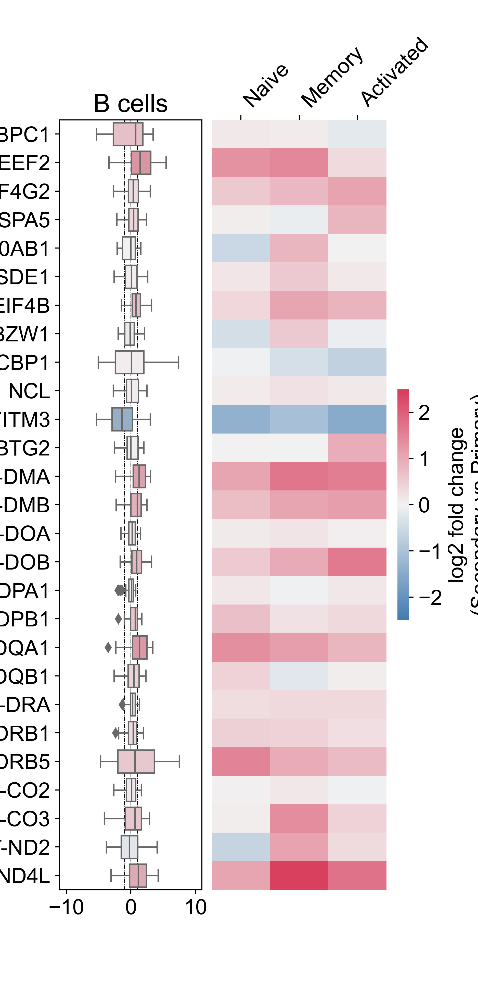

<IPython.core.display.Javascript object>


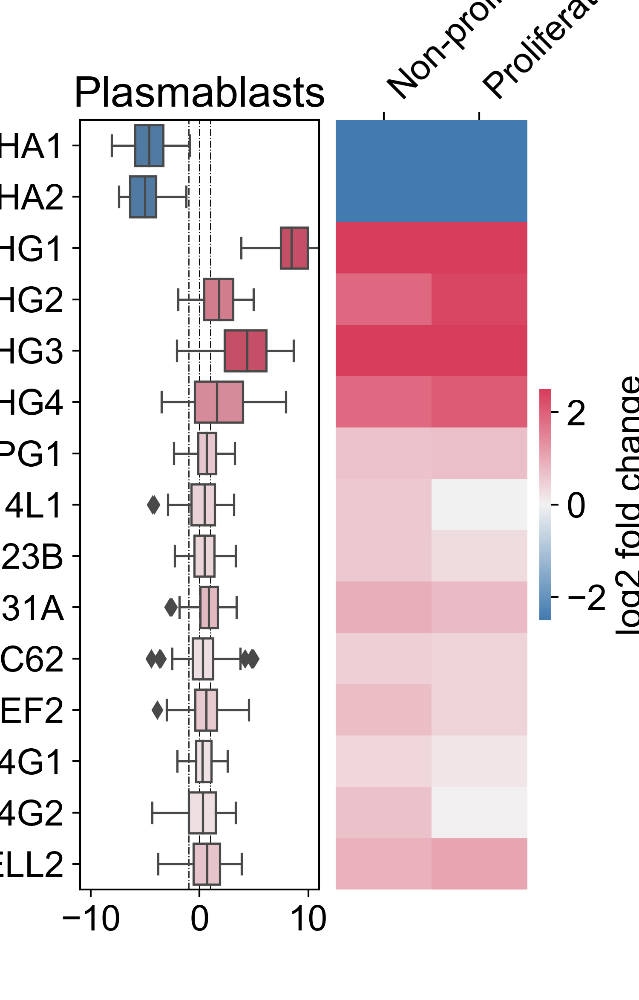

<IPython.core.display.Javascript object>


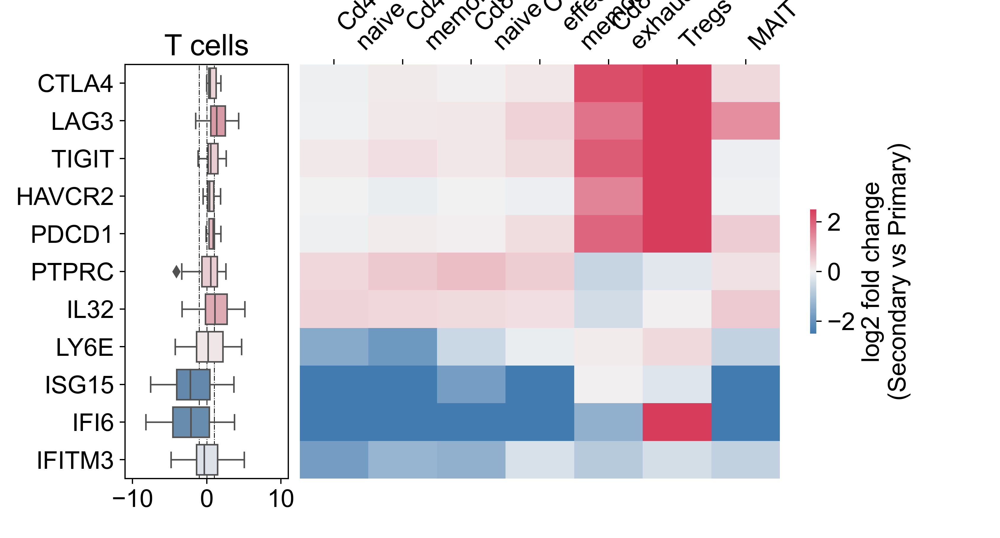

<IPython.core.display.Javascript object>


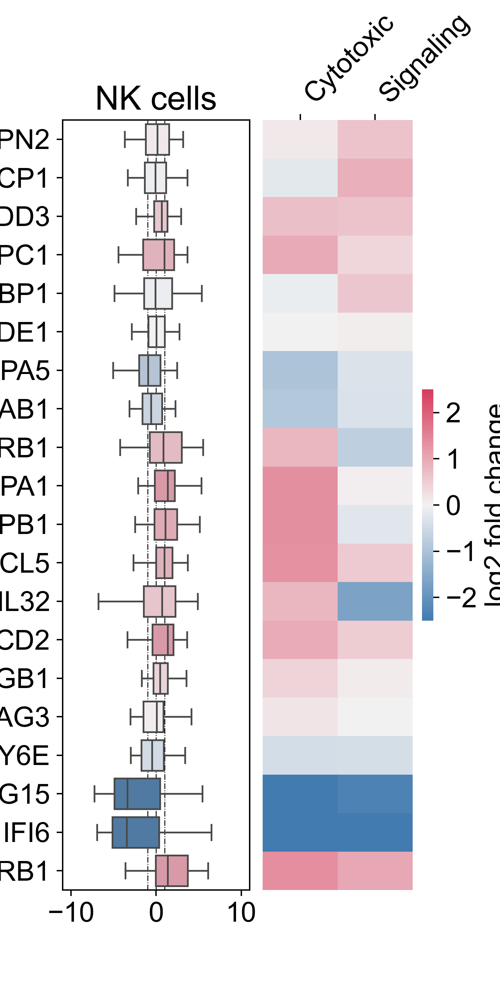

<IPython.core.display.Javascript object>


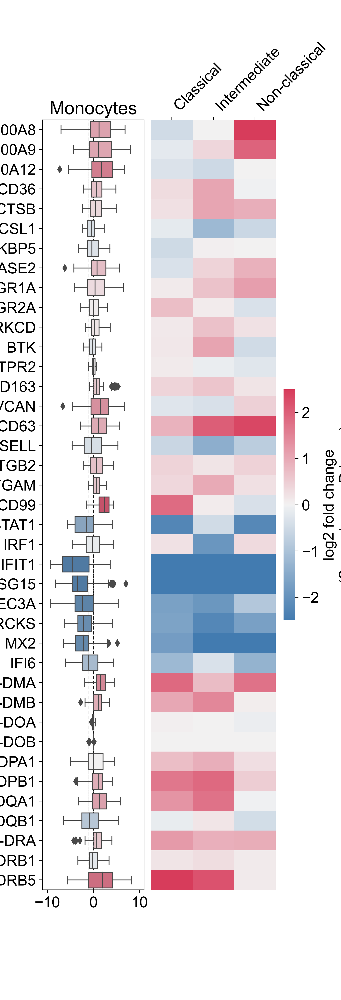

<IPython.core.display.Javascript object>


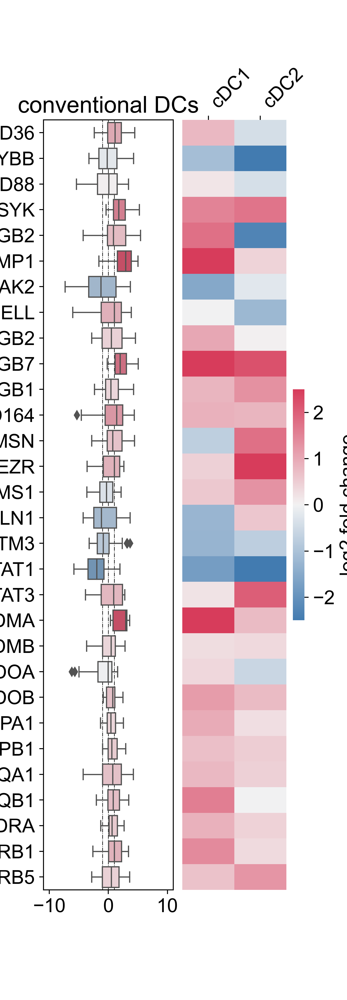

In [355]:
ct_csts = {
 'B cells': ['naive B cells', 'memory B cells', 'activated B cells'],
 'Plasmablasts': ['non-proliferating plasmablasts', 'proliferating plasmablasts'],
 'T cells': ['CD4+ naive T cells',
             'CD4+ memory T cells',
             'CD8+ naive T cells',
             'CD8+ effector memory T cells',
             'CD8+ exhausted T cells',
             'Tregs',
             'MAIT',],
 'NK cells': ['cytotoxic NK cells', 'signaling NK cells'],
 'Monocytes': ['classical monocytes', 'intermediate monocytes', 'non-classical monocytes', ],
 'conventional DCs': ['cDC1', 'cDC2'],
}

for ct in ct_csts.keys():
    com_box_heatmap(ct_log2FC, cst_pair, ct, ct_csts[ct], genes[ct], 
                    'Secondary', 'Primary', path='DEGs_{}.pdf'.format(ct))

<IPython.core.display.Javascript object>


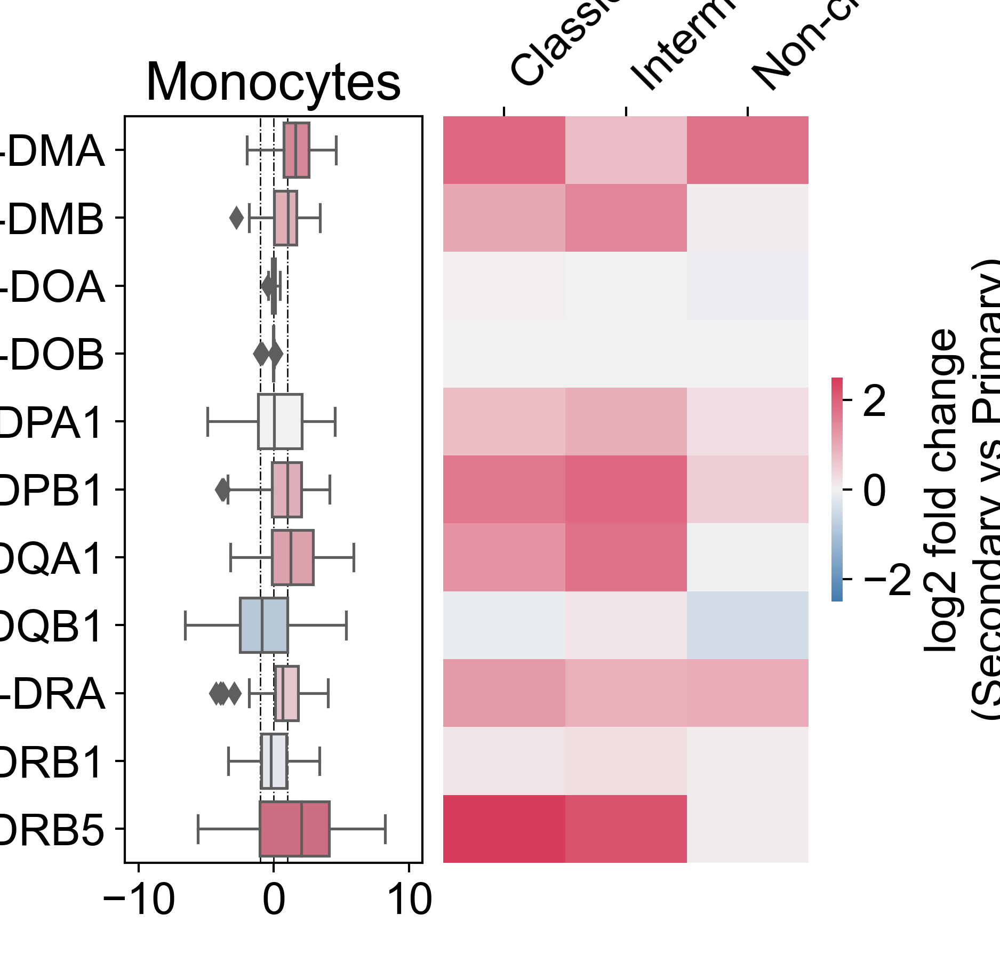

{'figure': <Figure size 1500x1455 with 3 Axes>,
 'ax': [<AxesSubplot: title={'center': 'Monocytes'}>, <AxesSubplot: >]}

In [371]:
ct = 'Monocytes'
MHC_genes = [
 'HLA-DMA',
 'HLA-DMB',
 'HLA-DOA',
 'HLA-DOB',
 'HLA-DPA1',
 'HLA-DPB1',
 'HLA-DQA1',
 'HLA-DQB1',
 'HLA-DRA',
 'HLA-DRB1',
 'HLA-DRB5'
]

com_box_heatmap(ct_log2FC, pair, ct, ct_csts[ct], MHC_genes, 
                'Secondary', 'Primary', path='MHCII_{}.pdf'.format(ct))

#### secondary vs. primary in D/DWS

In [29]:
# D & DWS
adata_kid_D_DWS = adata_kid[adata_kid.obs['Condition'].isin(['dengue', 'DWS'])]

# cell_type
ct_obs = 'cell_type_new'
cd_SD = ['Secondary']
cd_D = ['Primary']
cd_obs = 'Dengue_exposure'
cts = [[i] for i in adata_kid.obs['cell_type_new'].unique().tolist()]
pair_res = pair_comparison(adata_kid_D_DWS, ct_obs, cd_obs, cd_SD, cd_D, 
                           cts, gene_cut_off=False, log1p=2)

pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
pair_res['pair_res'].to_csv(save_tables +  'DE_ct_pair_nonprogressors.tsv')
pair_res['log_FCs'].to_csv(save_tables + 'DE_ct_log2FC_nonprogressors.tsv')

# cell subtype
ct_obs = 'cell_subtype_new'
cd_SD = ['Secondary']
cd_D = ['Primary']
cd_obs = 'Dengue_exposure'
cts = [[i] for i in adata_kid.obs['cell_subtype_new'].unique().tolist()]
pair_res = pair_comparison(adata_kid_D_DWS, ct_obs, cd_obs, cd_SD, cd_D, 
                           cts, gene_cut_off=False, log1p=2)

pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
pair_res['pair_res'].to_csv(save_tables +  'DE_cst_pair_nonprogressors.tsv')
pair_res['log_FCs'].to_csv(save_tables + 'DE_cst_log2FC_nonprogressors.tsv')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [30]:
# ct_pair_nonP = pd.read_csv(save_tables + 'DE_ct_pair_nonprogressors.tsv', 
#                       sep=',', index_col=['cell_subtype', 'gene'])
ct_log2FC_nonP = pd.read_csv(save_tables + 'DE_ct_log2FC_nonprogressors.tsv', 
                        sep=',', index_col=0)

cst_pair_nonP = pd.read_csv(save_tables + 'DE_cst_pair_nonprogressors.tsv', 
                       sep=',', index_col=['cell_subtype', 'gene'])
# cst_log2FC_nonP = pd.read_csv(save_tables + 'DE_cst_log2FC_nonprogressors.tsv', 
#                          sep=',', index_col=0)

{'figure': <Figure size 1500x1455 with 3 Axes>,
 'ax': [<AxesSubplot: title={'center': 'Monocytes'}>, <AxesSubplot: >]}

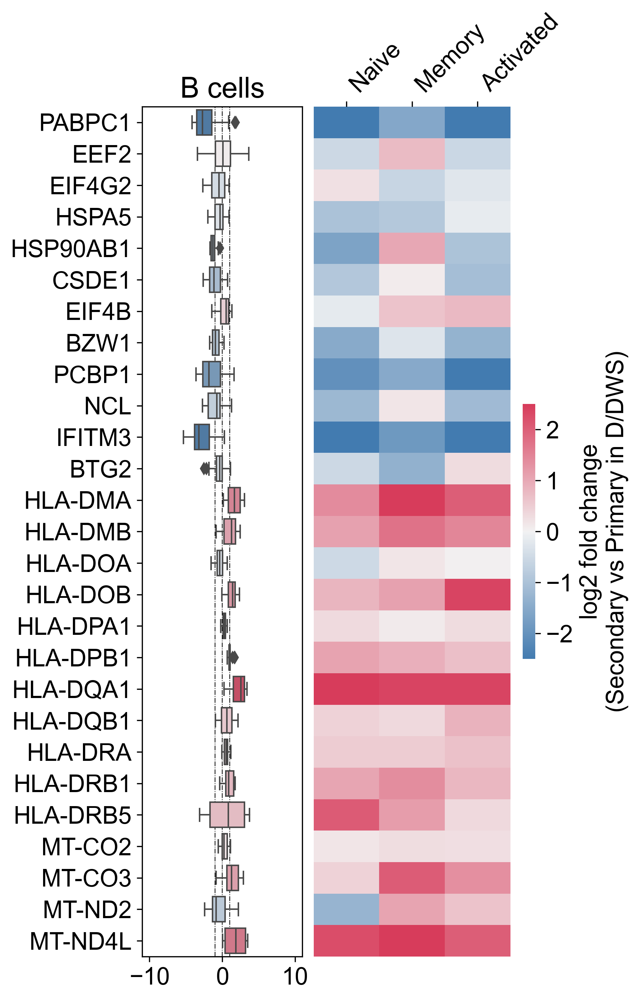

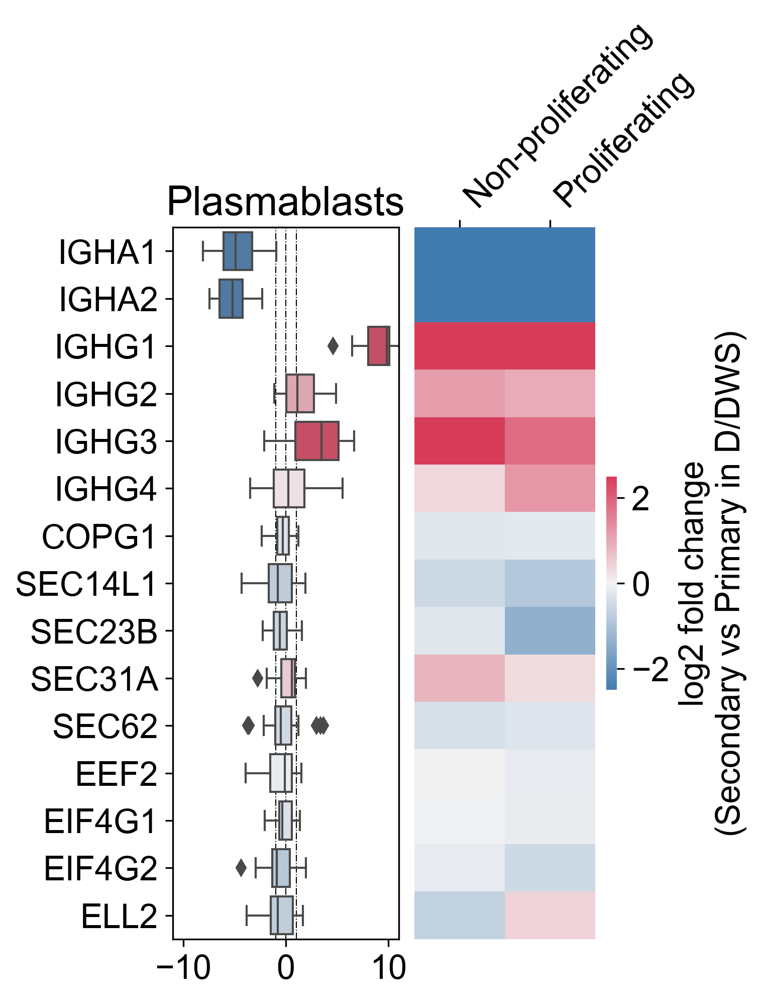

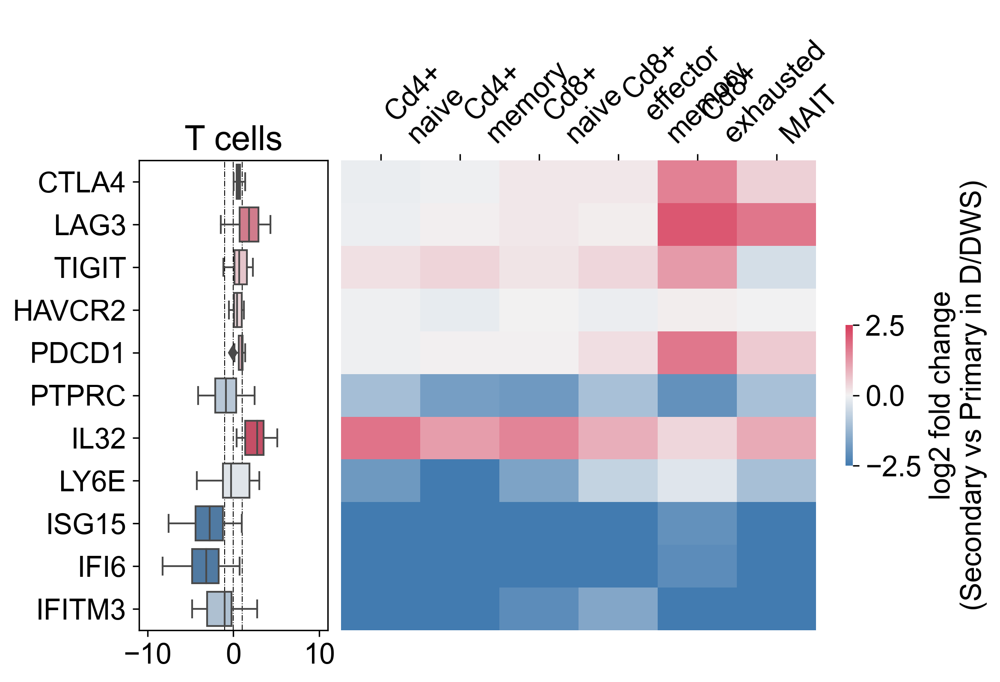

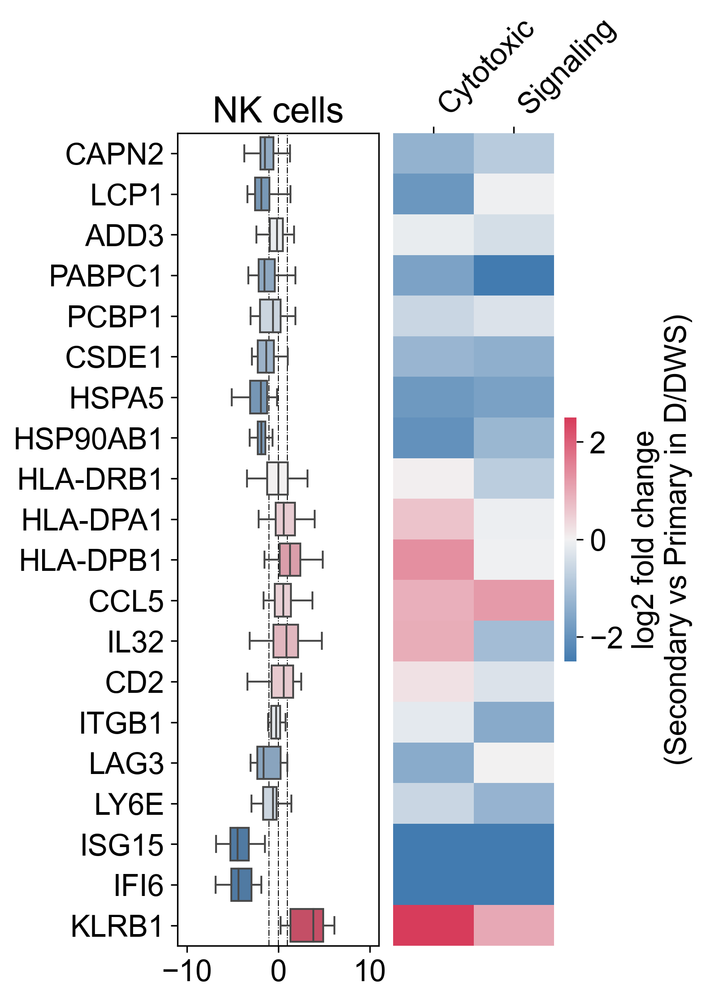

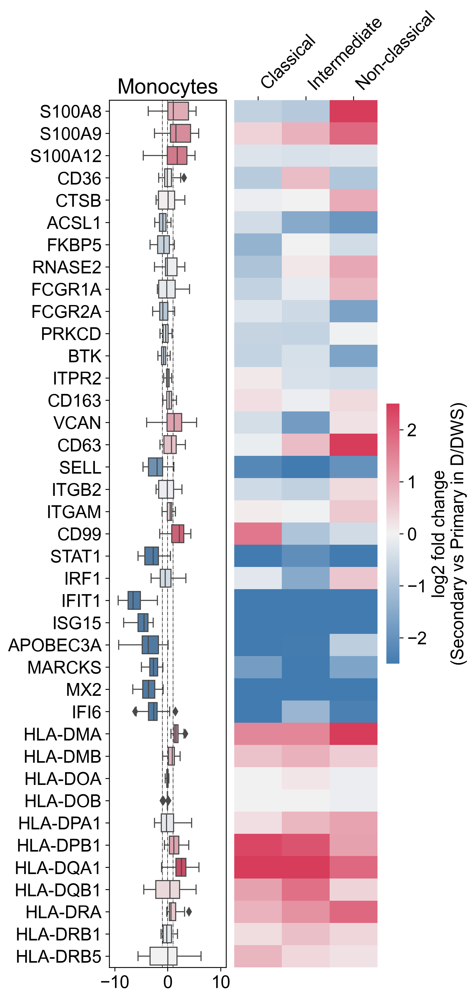

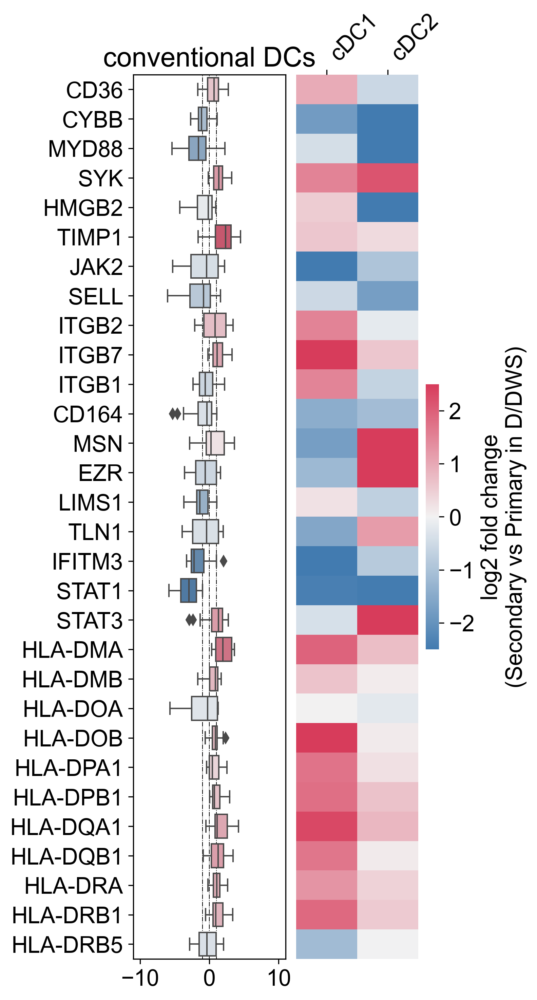

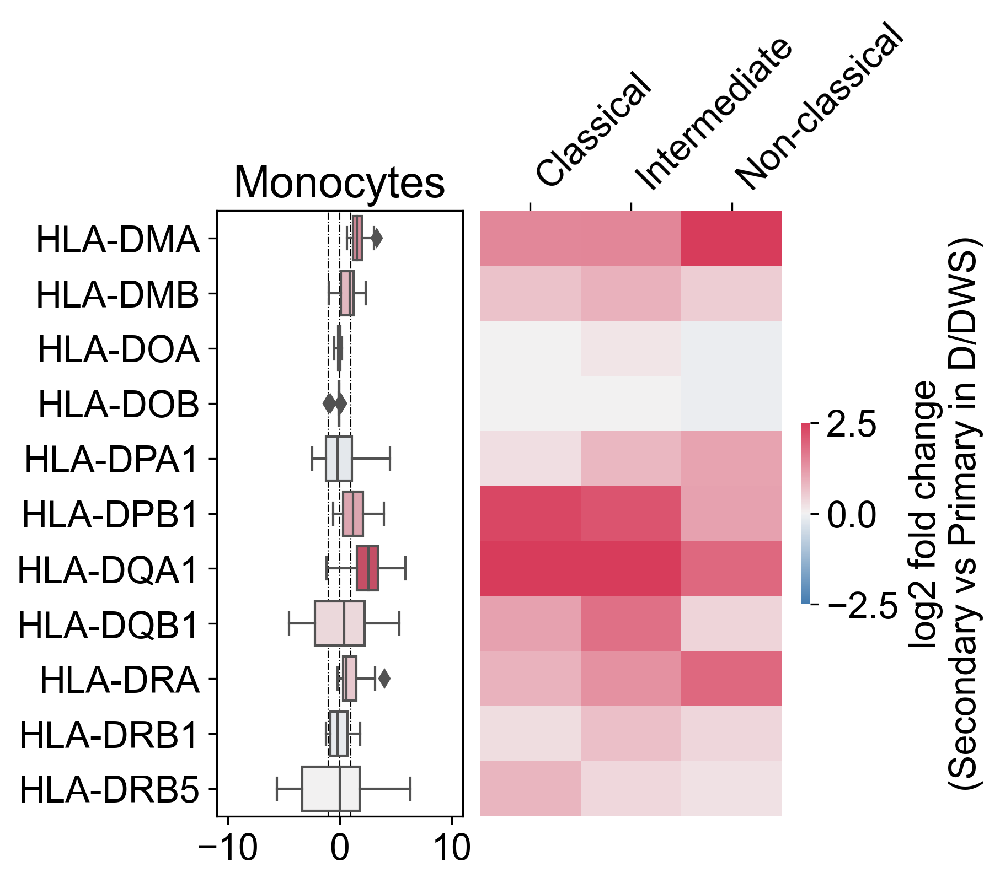

In [39]:
ct_csts = {
 'B cells': ['naive B cells', 'memory B cells', 'activated B cells'],
 'Plasmablasts': ['non-proliferating plasmablasts', 'proliferating plasmablasts'],
 'T cells': ['CD4+ naive T cells',
             'CD4+ memory T cells',
             'CD8+ naive T cells',
             'CD8+ effector memory T cells',
             'CD8+ exhausted T cells',
#              'Tregs',
             'MAIT',],
 'NK cells': ['cytotoxic NK cells', 'signaling NK cells'],
 'Monocytes': ['classical monocytes', 'intermediate monocytes', 'non-classical monocytes', ],
 'conventional DCs': ['cDC1', 'cDC2'],
}

for ct in ct_csts.keys():
    com_box_heatmap(ct_log2FC_nonP, cst_pair_nonP, ct, ct_csts[ct], genes[ct], 
                    'Secondary', 'Primary in D/DWS', 
                    path='dengue_exposure_nonprogressors/DEGs_{}.pdf'.format(ct))

################
ct = 'Monocytes'
MHC_genes = [
 'HLA-DMA',
 'HLA-DMB',
 'HLA-DOA',
 'HLA-DOB',
 'HLA-DPA1',
 'HLA-DPB1',
 'HLA-DQA1',
 'HLA-DQB1',
 'HLA-DRA',
 'HLA-DRB1',
 'HLA-DRB5'
]

com_box_heatmap(ct_log2FC_nonP, cst_pair_nonP, ct, ct_csts[ct], MHC_genes, 
                'Secondary', 'Primary in D/DWS', 
                path='dengue_exposure_nonprogressors/MHCII_{}.pdf'.format(ct))

#### secondary vs. primary in SDp

In [40]:
# SDp
adata_kid_SD = adata_kid[adata_kid.obs['Condition'] == 'S_dengue']

# cell_type
ct_obs = 'cell_type_new'
cd_SD = ['Secondary']
cd_D = ['Primary']
cd_obs = 'Dengue_exposure'
cts = [[i] for i in adata_kid.obs['cell_type_new'].unique().tolist()]
pair_res = pair_comparison(adata_kid_SD, ct_obs, cd_obs, cd_SD, cd_D, cts, gene_cut_off=False, log1p=2)

pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
pair_res['pair_res'].to_csv(save_tables +  'DE_ct_pair_SDp.tsv')
pair_res['log_FCs'].to_csv(save_tables + 'DE_ct_log2FC_SDp.tsv')

# cell subtype
ct_obs = 'cell_subtype_new'
cd_SD = ['Secondary']
cd_D = ['Primary']
cd_obs = 'Dengue_exposure'
cts = [[i] for i in adata_kid.obs['cell_subtype_new'].unique().tolist()]
pair_res = pair_comparison(adata_kid_SD, ct_obs, cd_obs, cd_SD, cd_D, cts, gene_cut_off=False, log1p=2)

pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
pair_res['pair_res'].to_csv(save_tables +  'DE_cst_pair_SDp.tsv')
pair_res['log_FCs'].to_csv(save_tables + 'DE_cst_log2FC_SDp.tsv')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [41]:
# ct_pair_SD = pd.read_csv(save_tables + 'DE_ct_pair.tsv', sep=',', index_col=['cell_subtype', 'gene'])
ct_log2FC_SDp = pd.read_csv(save_tables + 'DE_ct_log2FC_SDp.tsv', 
                            sep=',', index_col=0)

cst_pair_SDp = pd.read_csv(save_tables + 'DE_cst_pair_SDp.tsv', 
                           sep=',', index_col=['cell_subtype', 'gene'])
# cst_log2FC_SD = pd.read_csv(save_tables + 'DE_cst_log2FC.tsv', sep=',', index_col=0)

{'figure': <Figure size 1500x1455 with 3 Axes>,
 'ax': [<AxesSubplot: title={'center': 'Monocytes'}>, <AxesSubplot: >]}

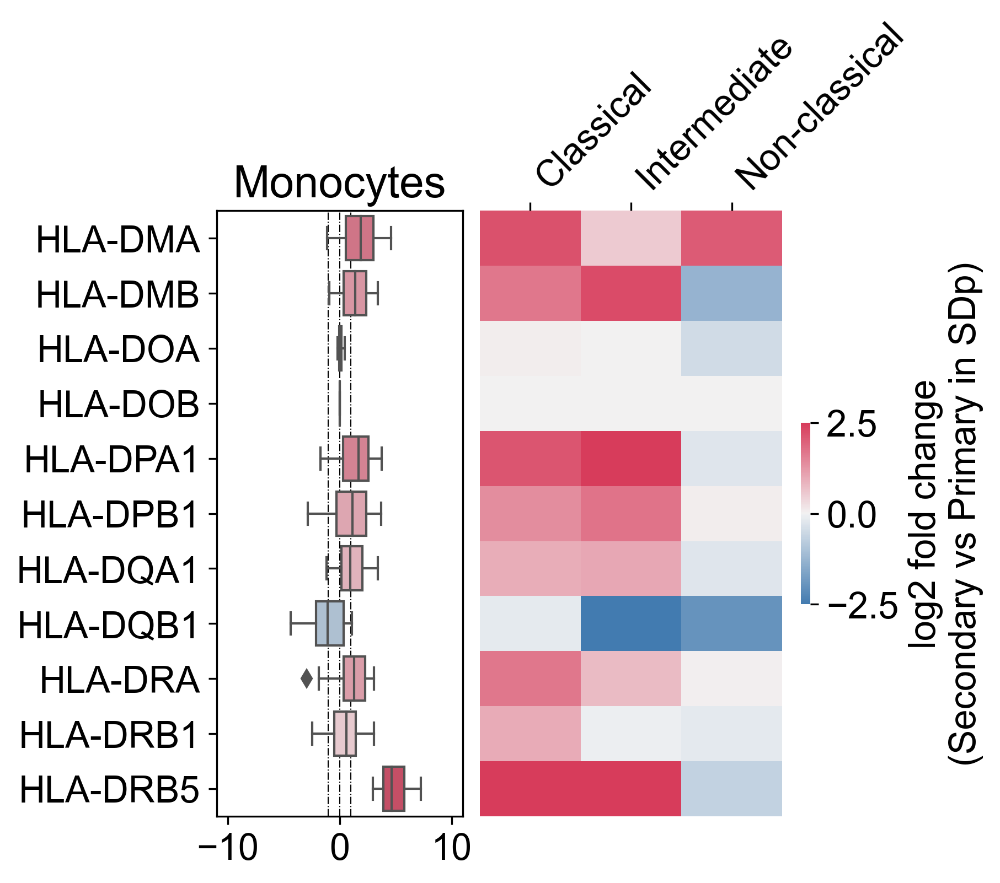

In [43]:
ct_csts = {
 'B cells': ['naive B cells', 'memory B cells', 'activated B cells'],
 'Plasmablasts': ['non-proliferating plasmablasts', 'proliferating plasmablasts'],
 'T cells': ['CD4+ naive T cells',
             'CD4+ memory T cells',
             'CD8+ naive T cells',
             'CD8+ effector memory T cells',
             'CD8+ exhausted T cells',
             'Tregs',
             'MAIT',],
 'NK cells': ['cytotoxic NK cells', 'signaling NK cells'],
 'Monocytes': ['classical monocytes', 'intermediate monocytes', 'non-classical monocytes', ],
 'conventional DCs': ['cDC1', 'cDC2'],
}

for ct in ct_csts.keys():
    com_box_heatmap(ct_log2FC_SDp, cst_pair_SDp, ct, ct_csts[ct], genes[ct], 
                    'Secondary', 'Primary in SDp', path='dengue_exposure_SDp/DEGs_{}.pdf'.format(ct))

######
ct = 'Monocytes'
MHC_genes = [
 'HLA-DMA',
 'HLA-DMB',
 'HLA-DOA',
 'HLA-DOB',
 'HLA-DPA1',
 'HLA-DPB1',
 'HLA-DQA1',
 'HLA-DQB1',
 'HLA-DRA',
 'HLA-DRB1',
 'HLA-DRB5'
]

com_box_heatmap(ct_log2FC_SDp, cst_pair_SDp, ct, ct_csts[ct], MHC_genes, 
                'Secondary', 'Primary in SDp', path='dengue_exposure_SDp/MHCII_{}.pdf'.format(ct))

#### primary vs secondary in D/DWS or secondary in SD

In [170]:
sec_SD = ['1_002_01', '1_144_01', '5_030_01', '5_044_01', '5_193_01']
sec_D = ['1_113_01', '5_010_01', '5_130_01', '6_023_01', '6_029_01']

In [171]:
for ex_IDs, name in zip([sec_SD, sec_D], ['pri_all_sec_non_SDp/', 'pri_all_sec_SDp/']):
    # SDp
    adata_kid_SD = adata_kid[~ adata_kid.obs['ID'].isin(ex_IDs)]

    # cell_type
    ct_obs = 'cell_type_new'
    cd_SD = ['Secondary']
    cd_D = ['Primary']
    cd_obs = 'Dengue_exposure'
    cts = [[i] for i in adata_kid.obs['cell_type_new'].unique().tolist()]
    pair_res = pair_comparison(adata_kid_SD, ct_obs, cd_obs, cd_SD, cd_D, cts, gene_cut_off=False, log1p=2)

    pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
    pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
    pair_res['pair_res'].to_csv(save_tables + name + 'DE_ct_pair.tsv')
    pair_res['log_FCs'].to_csv(save_tables + name + 'DE_ct_log2FC.tsv')

    # cell subtype
    ct_obs = 'cell_subtype_new'
    cd_SD = ['Secondary']
    cd_D = ['Primary']
    cd_obs = 'Dengue_exposure'
    cts = [[i] for i in adata_kid.obs['cell_subtype_new'].unique().tolist()]
    pair_res = pair_comparison(adata_kid_SD, ct_obs, cd_obs, cd_SD, cd_D, cts, gene_cut_off=False, log1p=2)

    pair_res['pair_res']['cell_subtype'] = pair_res['pair_res']['cell_subtype'].str.rstrip('_')
    pair_res['log_FCs'].index = pair_res['log_FCs'].index.str.rstrip('_')
    pair_res['pair_res'].to_csv(save_tables +  name + 'DE_cst_pair.tsv')
    pair_res['log_FCs'].to_csv(save_tables + name + 'DE_cst_log2FC.tsv')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

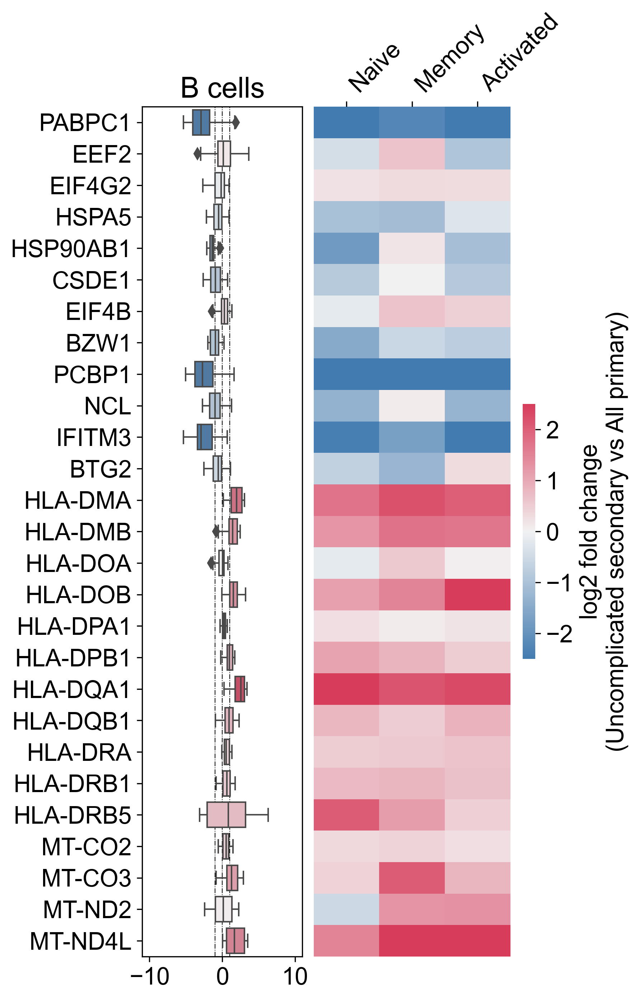

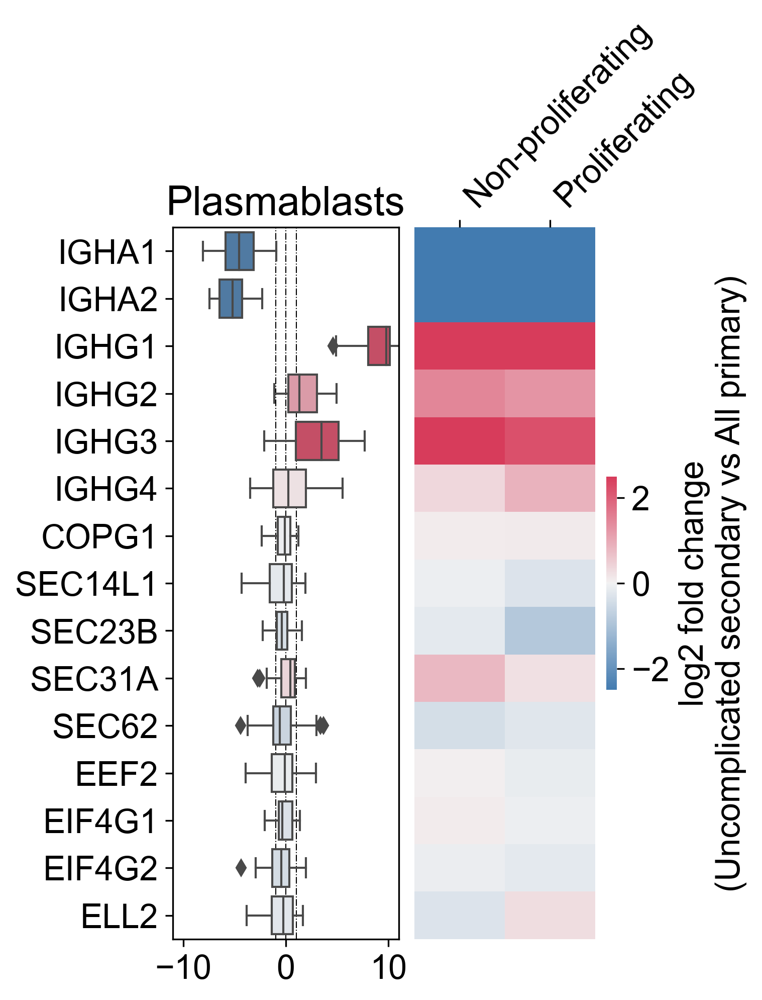

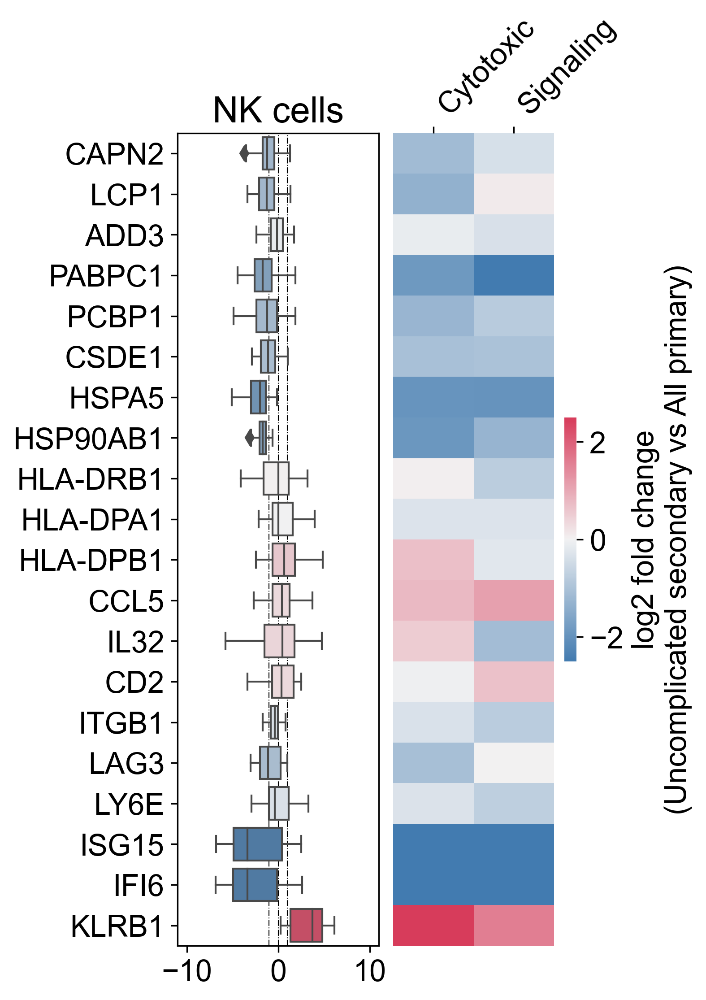

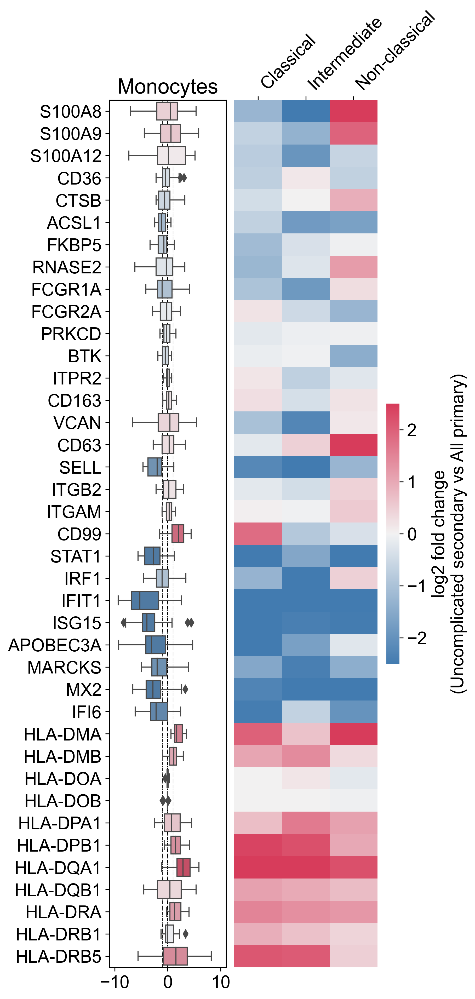

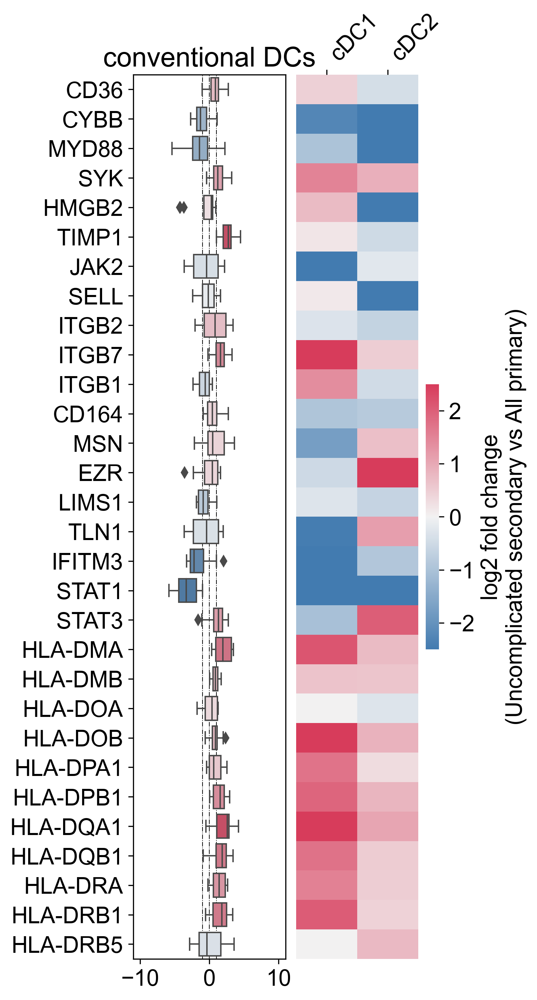

...

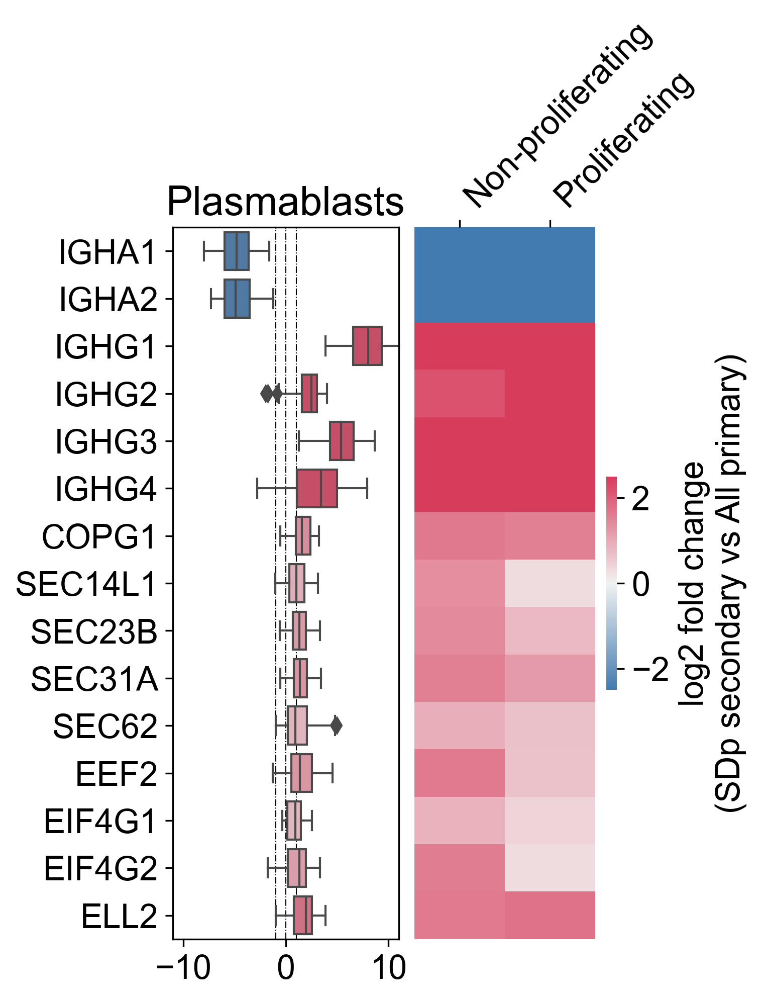

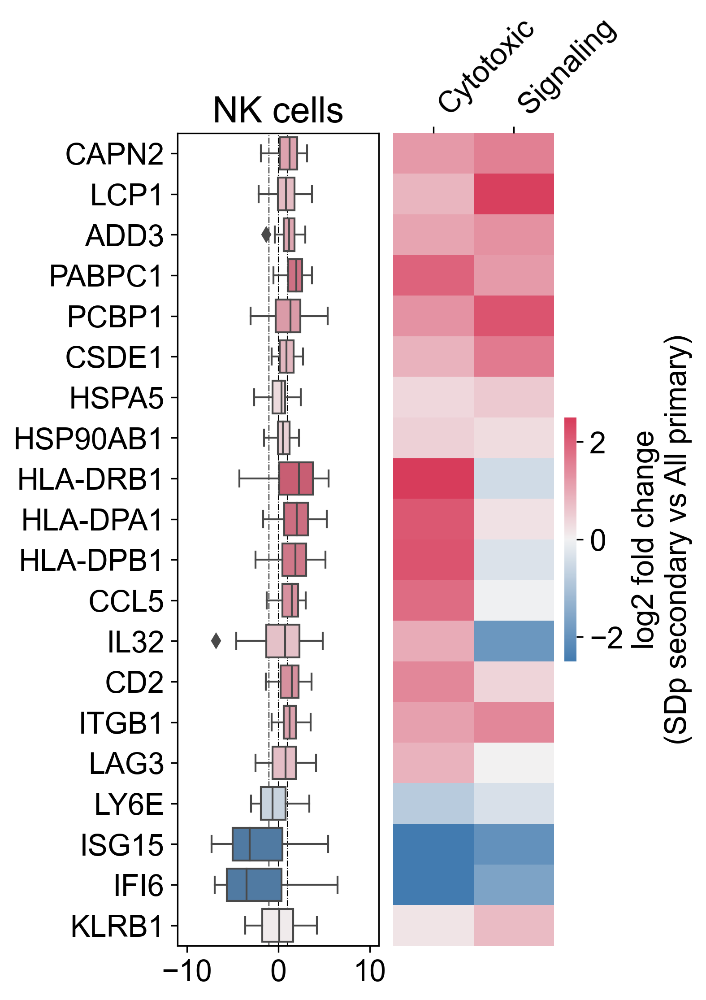

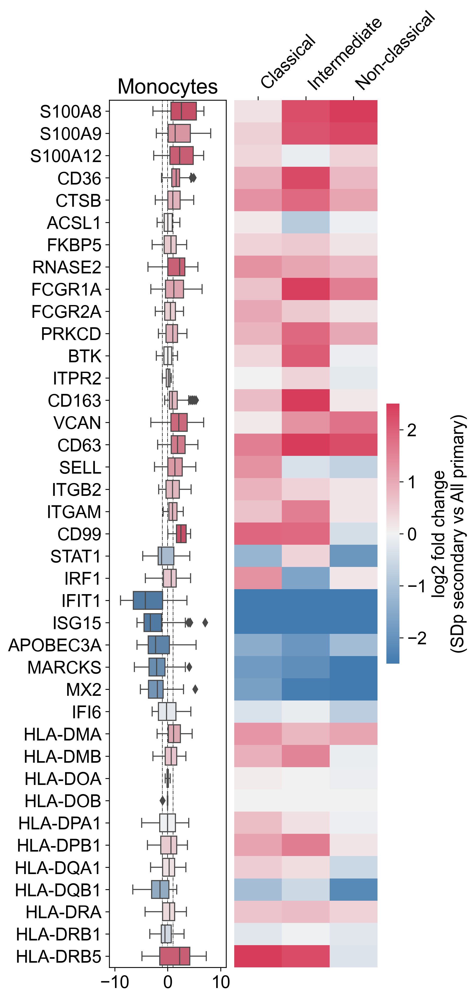

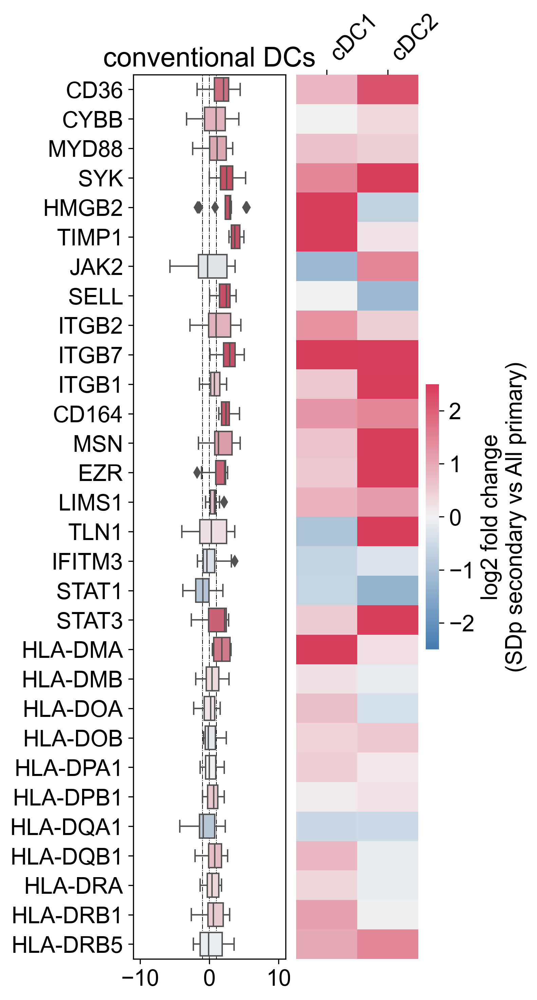

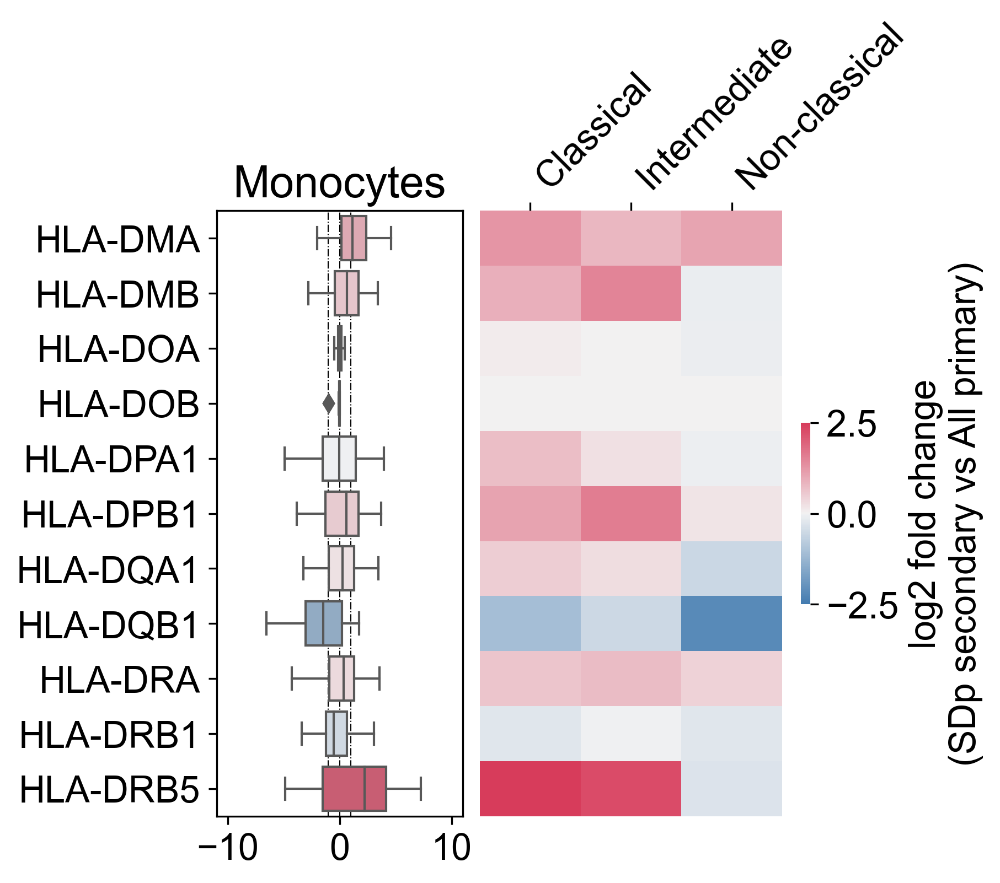

In [198]:
for name, cd in zip(['pri_all_sec_non_SDp/', 'pri_all_sec_SDp/'], ['Uncomplicated', 'SDp']):
    # ct_pair_SD = pd.read_csv(save_tables + 'DE_ct_pair.tsv', sep=',', index_col=['cell_subtype', 'gene'])
    ct_log2FC_SDp = pd.read_csv(save_tables + name + 'DE_ct_log2FC.tsv', 
                                sep=',', index_col=0)

    cst_pair_SDp = pd.read_csv(save_tables + name + 'DE_cst_pair.tsv', 
                               sep=',', index_col=['cell_subtype', 'gene'])
    # cst_log2FC_SD = pd.read_csv(save_tables + 'DE_cst_log2FC.tsv', sep=',', index_col=0)

    ###############################################################################################
    ct_csts = {
     'B cells': ['naive B cells', 'memory B cells', 'activated B cells'],
     'Plasmablasts': ['non-proliferating plasmablasts', 'proliferating plasmablasts'],
#      'T cells': ['CD4+ naive T cells',
#                  'CD4+ memory T cells',
#                  'CD8+ naive T cells',
#                  'CD8+ effector memory T cells',
#                  'CD8+ exhausted T cells',
#                  'Tregs',
#                  'MAIT',],
     'NK cells': ['cytotoxic NK cells', 'signaling NK cells'],
     'Monocytes': ['classical monocytes', 'intermediate monocytes', 'non-classical monocytes', ],
     'conventional DCs': ['cDC1', 'cDC2'],
    }

    for ct in ct_csts.keys():
        com_box_heatmap(ct_log2FC_SDp, cst_pair_SDp, ct, ct_csts[ct], genes[ct], 
                        '{} secondary'.format(cd), 'All primary', path=name + name[:-1] + 'DEGs_{}.pdf'.format(ct))

    ######
    ct = 'Monocytes'
    MHC_genes = [
     'HLA-DMA',
     'HLA-DMB',
     'HLA-DOA',
     'HLA-DOB',
     'HLA-DPA1',
     'HLA-DPB1',
     'HLA-DQA1',
     'HLA-DQB1',
     'HLA-DRA',
     'HLA-DRB1',
     'HLA-DRB5'
    ]

    com_box_heatmap(ct_log2FC_SDp, cst_pair_SDp, ct, ct_csts[ct], MHC_genes, 
                    '{} secondary'.format(cd), 'All primary', path=name + name[:-1] + 'MHCII_{}.pdf'.format(ct))

### bootstraping analysis between VHCs and bystanders

In [40]:
def pre_processing_2(adata):
    temp = adata.copy()
#     sc.pp.filter_genes(temp, min_cells=3)
    
    virus_nor(temp)
    
    temp.obs['bystanders'] = 'high'
    temp.obs.loc[temp.obs.DENV_reads_nor==0, 'bystanders'] = 'zero'
    
    return(temp)

# w/o replacement
def sampling(adata):
    # w/o replacement
    from random import sample
    ind_bystander = list(adata[adata.obs.loc[:,'bystanders'] == 'zero',].obs.index)
    length_vhc = len(adata[adata.obs.loc[:,'bystanders'] == 'high',].obs.index)
    samplelist = sample(ind_bystander, length_vhc)
    
    return(samplelist)

def dge_KS_2(adata, samplelist, p):
    adata_1 = adata[np.in1d(adata.obs.index, samplelist),:]
    adata_2 = adata[adata.obs.loc[:,'bystanders'] == 'high',:]
    results = anndataks.compare(adata_1, adata_2, log1p=2)
    results_sort = results.sort_values(by = 'statistic', ascending=False)
    results_sort['-log10p'] = pd.Series(-np.log10(results_sort['pvalue']))
    results_sort_2 = results_sort[(results_sort['log2_fold_change'].abs() > 1)].copy()
    
    return(results_sort, results_sort_2)

def bootstrap_2(adata, n, p):
    dic_1 = {}
    dic_2 = {}
    for x in np.arange(n):
        sample_list = sampling(adata)
        result_temp_1,  result_temp_2 = dge_KS_2(adata, sample_list, p)
        dic_1[x] = result_temp_1
        dic_2[x] = result_temp_2
        
    gene = []
    for key in dic_2.keys():
        gene = gene + list(dic_2[key].index)
    a = pd.Series(gene).value_counts().to_frame()
    
    return(dic_1, dic_2, a)


### replacement
def sampling_2(adata, group):
    # with replacement
    from random import choices
    ind_bystander = list(adata[adata.obs.loc[:,'bystanders'] == group,].obs.index)
    length_vhc = len(adata[adata.obs.loc[:,'bystanders'] == 'high',].obs.index)
    samplelist = choices(ind_bystander, k=length_vhc)
    
    return(samplelist)

def dge_KS_3(adata, samplelist_b, samplelist_v, p):
    adata_1 = adata[np.in1d(adata.obs.index, samplelist_b),:]
    adata_2 = adata[np.in1d(adata.obs.index, samplelist_v),:]
    results = anndataks.compare(adata_1, adata_2, log1p=2)
    results_sort = results.sort_values(by = 'statistic', ascending=False)
    results_sort['-log10p'] = pd.Series(-np.log10(results_sort['pvalue']))
    results_sort_2 = results_sort[(results_sort['log2_fold_change'].abs() > 1)].copy()
    
    return(results_sort, results_sort_2)

def bootstrap_3(adata, n, p):
    dic_1 = {}
    dic_2 = {}
    for x in np.arange(n):
        samplelist_b = sampling_2(adata, 'zero')
        samplelist_v = sampling_2(adata, 'high')
        result_temp_1,  result_temp_2 = dge_KS_3(adata, samplelist_b, samplelist_v, p)
        dic_1[x] = result_temp_1
        dic_2[x] = result_temp_2
        
    gene = []
    for key in dic_2.keys():
        gene = gene + list(dic_2[key].index)
    a = pd.Series(gene).value_counts().to_frame()
    
    return(dic_1, dic_2, a)

# merge results
def dicmerge(dic, gene_list):
    df_temp = pd.DataFrame(columns = np.arange(100), index = gene_list)
    for key in dic.keys():
        df_temp.loc[:,key] = dic[key].loc[gene_list].log2_fold_change
    df_temp['median'] = df_temp.median(axis = 1)
    return(df_temp)

def bar_plot_other_celltype(dic_list, genelist):    
    new_list = []
    for dic in dic_list:      
        df_temp = dicmerge(dic, genelist)
#         df_temp = df_temp.sort_values(by = 'median', ascending = False)
        new_list.append(df_temp)
    
    return(new_list) 

#### w/o replacement

In [15]:
common = [ 'HLA-DMA',
         'HLA-DMB',
         'HLA-DOA',
         'HLA-DOB',
         'HLA-DPA1',
         'HLA-DPB1',
         'HLA-DQA1',
         'HLA-DQB1',
         'HLA-DRA',
         'HLA-DRB1',
         'HLA-DRB5',
         'CD163'] 

ag_gs1 = [
    # antigen presentation
    'HLA-A', 'HLA-B', 'HLA-C',
    'TAP1', 'TAP2',
    'ERAP1', 'ERAP2',
    'B2M']

ag_gs2 = [
    # antigen presentation
    'HLA-DMA', 'HLA-DMB', # HLA-DM
    'HLA-DOA', 'HLA-DOB', # HLA-DO
    'PSMB8', 'PSMB9', 'PSMB10', #'LMP7','LMP2', 'LMP10'
    'CD74', 'IFNG',
    'IFI30', 
    'CST3'
]

cp_gs = [
    # Cathepsins
    'CTSB', 'CTSL', 'CTSS', 'CTSZ', 'CTSF', 'CTSW', 'CTSD', 'CTSK', 'CTSG', 'CTSV' 
    ] # not expressed by enough cells 'CTSG', 'CTSV' ('CTSL2'), 
    
ap_gs = [
    # Aminopeptidase
    'ERAP1', 'ERAP2', 'NPEPPS', 'LAP3', 'XPNPEP1', 'METAP1', 'LNPEP', 'ANPEP', # don't have 'ENPEP', 
    # remove 'ACP5', 
    ]
        
ls_gs =[
    # Lysosome function
    'LAMP1', 'LAMP2', 'MCOLN1', 'CTSD', 'GAA', 'NPC1', 'NPC2', 'ATP6V0A2', 'CLN3',  'TFEB',#'TEEB',
]

genelist = np.unique(common + ag_gs1 + ag_gs2 + cp_gs + ap_gs + ls_gs + ['STAT1', 'STAT2', 'CIITA', 'LGMN', 'APOBEC3A'])

# temp = adata_kid[adata_kid.obs['Condition'] != 'Healthy'].copy()
temp = adata_kid[adata_kid.obs['ID'].isin(['6_025_01', '5_089_01', '6_020_01'])]

#B
adata_temp = temp[temp.obs.cell_type_new == 'B cells'].copy()
adata_temp = pre_processing_2(adata_temp)
adata_temp = adata_temp[:, genelist]
dic_b_1, dic_b_2, df_b = bootstrap_2(adata_temp, 100, 2)

#monocytes
adata_temp = temp[temp.obs.cell_type_new == 'Monocytes'].copy()
adata_temp = pre_processing_2(adata_temp)
adata_temp = adata_temp[:, genelist]
dic_m_1, dic_m_2, df_m = bootstrap_2(adata_temp, 100, 2)

#NK
adata_temp = temp[temp.obs.cell_type_new == 'NK cells'].copy()
adata_temp = pre_processing_2(adata_temp)
adata_temp = adata_temp[:, genelist]
dic_n_1, dic_n_2, df_n = bootstrap_2(adata_temp, 100, 2)

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
Trying to set attribute `.obs` of view, copying.
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureW

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndataks/adata.py:93: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  res = ks_2samp(data1, data2, alternative=alternative, mode=mode)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [49]:
dic_list = [dic_b_1, dic_m_1, dic_n_1]
n_cutoff_list = [df_b, df_m, df_n]

df_list = bar_plot_other_celltype(dic_list, np.unique(genelist))

heatmap_df = pd.DataFrame(columns=['B cells', 'Monocytes', 'NK cells'], index=df_list[0].index)
for col, df in zip(['B cells', 'Monocytes', 'NK cells'], df_list):
    heatmap_df[col] = df.median(axis=1)

heatmap_df.to_csv(save_tables + 'boostrap_VHC_vs_bystanders_all.tsv', sep='\t')

#### with replacement

In [41]:
main_gl = ['MT-CO3',
 'MT-ND4',
 'MT-ND4L',
 'CD69',
 'CXCR4',
 'FCER2',
 'TCL1A',
 'FCRLA',
 'FCRL3',
 'FCRL5',
 'SYK',
 'HCK',
 'FGR',
 'TXNIP',
 'LTB',
 'CIB1',
 'TNFRSF1B',
 'MX1',
 'IFI6',
 'IFI30',
 'LY6E',
 'HLA-DRB5',
 'HLA-DPA1',
 'LSM7',
 'TCEA1',
 'HNRNPM',
 'WIPF1',
 'RABAC1',
 'SEPT2']

radar_gl = pd.read_csv(save_tables + 'boostrap_VHC_vs_bystanders_all.tsv', sep='\t', index_col=0).index.tolist()
genelist = np.unique(main_gl + radar_gl)

In [42]:
# temp = adata_kid[adata_kid.obs['Condition'] != 'Healthy'].copy()
temp = adata_kid[adata_kid.obs['ID'].isin(['6_025_01', '5_089_01', '6_020_01'])]

#B
adata_temp = temp[temp.obs.cell_type_new == 'B cells'].copy()
adata_temp = pre_processing_2(adata_temp)
adata_temp = adata_temp[:, genelist]
dic_b_1, dic_b_2, df_b = bootstrap_3(adata_temp, 100, 2)

#monocytes
adata_temp = temp[temp.obs.cell_type_new == 'Monocytes'].copy()
adata_temp = pre_processing_2(adata_temp)
adata_temp = adata_temp[:, genelist]
dic_m_1, dic_m_2, df_m = bootstrap_3(adata_temp, 100, 2)

#NK
adata_temp = temp[temp.obs.cell_type_new == 'NK cells'].copy()
adata_temp = pre_processing_2(adata_temp)
adata_temp = adata_temp[:, genelist]
dic_n_1, dic_n_2, df_n = bootstrap_3(adata_temp, 100, 2)

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
Trying to set attribute `.obs` of view, copying.
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureW

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
Trying to set attribute `.obs` of view, copying.
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureW

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [43]:
cts = ['B cells', 'Monocytes', 'NK cells']
dic_list = [dic_b_1, dic_m_1, dic_n_1]

idx = []
for ct in cts:
    idx += [ct] * len(dic_list[0])
log2FCs = pd.DataFrame(index=idx, columns=genelist)

for ct, dic_1 in zip(cts, dic_list):
    val = np.empty((len(dic_1), len(genelist)))
    for i in range(len(dic_1)):
        val[i] = dic_1[i].loc[genelist]['log2_fold_change'].tolist() 
    log2FCs.loc[ct] = val

log2FCs.to_csv(save_figures + 'replacement_log2FCs.tsv', sep='\t')

In [44]:
dic_list = [dic_b_1, dic_m_1, dic_n_1]
n_cutoff_list = [df_b, df_m, df_n]

df_list = bar_plot_other_celltype(dic_list, np.unique(genelist))

heatmap_df = pd.DataFrame(columns=['B cells', 'Monocytes', 'NK cells'], index=df_list[0].index)
for col, df in zip(['B cells', 'Monocytes', 'NK cells'], df_list):
    heatmap_df[col] = df.median(axis=1)

heatmap_df.to_csv(save_tables + 'boostrap_VHC_vs_bystanders_replacement.tsv', sep='\t')

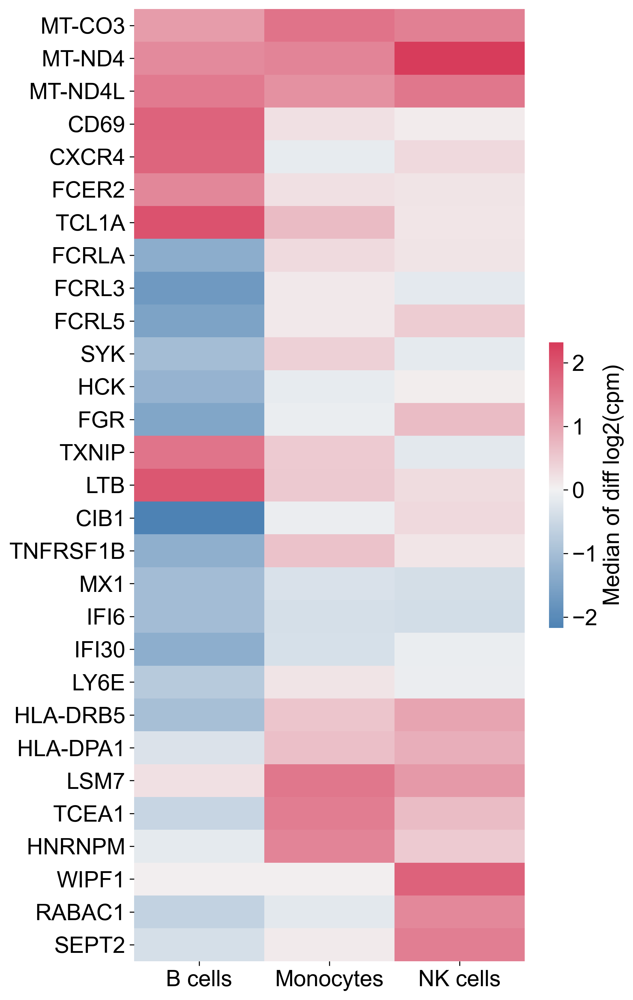

In [45]:
def heatmap_virus(df, path, filetype=False):
    rcParams['figure.figsize']=(7, 14)
    rcParams['font.size']=18
    rcParams['pdf.fonttype'] = 42
    rcParams['font.sans-serif'] = "Arial"
    rcParams['figure.dpi'] = 300

    fig, ax = plt.subplots()
    cmap = sns.diverging_palette(245, 5, as_cmap=True)
    ax = sns.heatmap(df, cmap=cmap, center=0, yticklabels=True,
                     cbar_kws={'label': 'Median of diff log2(cpm)', 'shrink': .3})
    if filetype is not False:
        plt.savefig(os.path.join(path, 'heatmap' + filetype),bbox_inches='tight')
        
heatmap_virus(heatmap_df.loc[main_gl], save_figures, '_DEGs_VHCs_replacement.pdf')

In [46]:
log2FCs = pd.read_csv(save_figures + 'replacement_log2FCs.tsv', sep='\t', index_col=0)

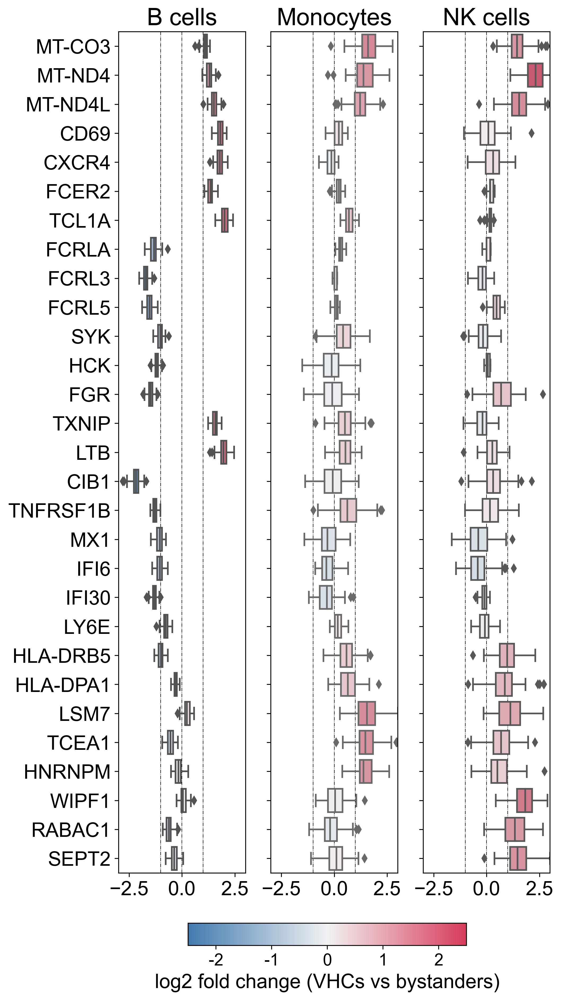

In [47]:
# boxplot to show noise
fig, axs = plt.subplots(1, 3, sharey=True)
cmap = sns.diverging_palette(245, 5, as_cmap=True)
norm = mpl.colors.Normalize(vmin=-2.5, vmax=2.5)

for i, ct in enumerate(cts):
    palette = [cmap(norm(x)) for x in np.clip(log2FCs.loc[ct][main_gl].median(axis=0), -2.5, 2.5)]
    sns.boxplot(data=log2FCs.loc[ct][main_gl], orient="h", ax=axs[i], palette=palette)
    axs[i].set_title(ct)
    axs[i].set_xlim(-3, 3)
    for x in [-1, 0, 1]:
        axs[i].axvline(x, c='black', ls='-.', lw=0.5, zorder=0.5)
    
ax_cb = fig.add_axes([0.25, 0.06, 0.5, 0.02])
cbar = mpl.colorbar.ColorbarBase(ax_cb, norm=norm, cmap=cmap, orientation='horizontal')
cbar.set_ticks([-2, -1, 0, 1, 2])
cbar.set_ticklabels(['-2', '-1', '0', '1', '2'])
cbar.ax.tick_params(labelsize=15)
cbar.set_label('log2 fold change (VHCs vs bystanders)')

fig.savefig(save_figures + 'box_DEGs_VHCs_replacement.pdf', bbox_inches='tight')

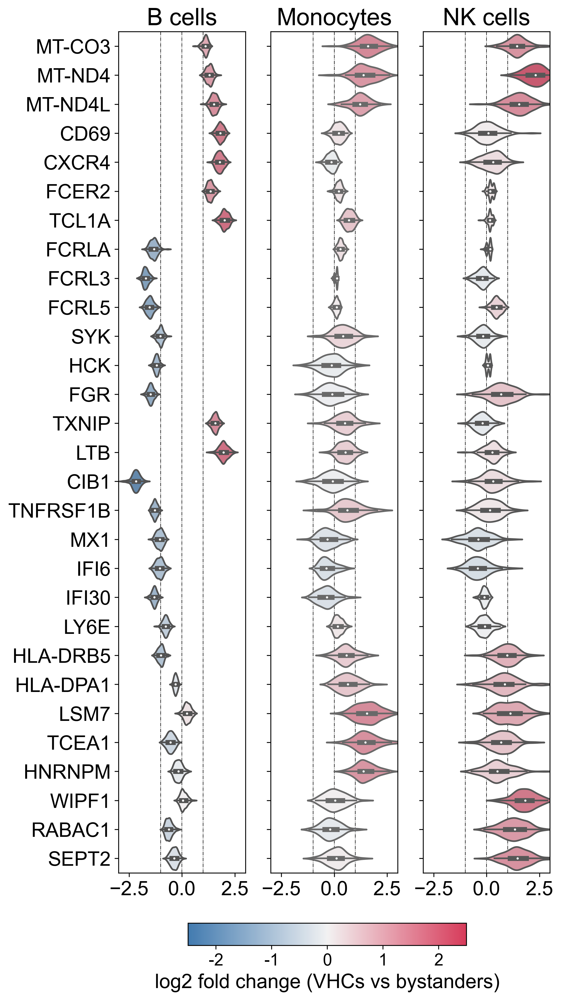

In [48]:
# violin plot to show noise
cts = ['B cells', 'Monocytes', 'NK cells']

rcParams['font.size']=18
rcParams['pdf.fonttype'] = 42
rcParams['font.sans-serif'] = "Arial"
rcParams['figure.figsize']=(7, 14)

fig, axs = plt.subplots(1, 3, sharey=True)
cmap = sns.diverging_palette(245, 5, as_cmap=True)
norm = mpl.colors.Normalize(vmin=-2.5, vmax=2.5)

for i, ct in enumerate(cts):
    palette = [cmap(norm(x)) for x in np.clip(log2FCs.loc[ct][main_gl].median(axis=0), -2.5, 2.5)]
    sns.violinplot(data=log2FCs.loc[ct][main_gl], orient="h", ax=axs[i], 
                   palette=palette, inner='box', scale='width') # 'quartile'
    axs[i].set_title(ct)
    axs[i].set_xlim(-3, 3)
        
    for x in [-1, 0, 1]:
        axs[i].axvline(x, c='black', ls='-.', lw=0.5, zorder=0.5)
    
ax_cb = fig.add_axes([0.25, 0.06, 0.5, 0.02])
cbar = mpl.colorbar.ColorbarBase(ax_cb, norm=norm, cmap=cmap, orientation='horizontal')
cbar.set_ticks([-2, -1, 0, 1, 2])
cbar.set_ticklabels(['-2', '-1', '0', '1', '2'])
cbar.ax.tick_params(labelsize=15)
cbar.set_label('log2 fold change (VHCs vs bystanders)')

fig.savefig(save_figures + 'violin_DEGs_VHCs_replacement.pdf', bbox_inches='tight')

In [162]:
a = adata_kid[adata_kid.obs['Dengue_exposure'] == 'Secondary'].obs.groupby(['Condition', 'ID']).size()

sec_SD = a.loc['S_dengue'][a.loc['S_dengue'] > 0].index.tolist()
sec_D = a.loc['S_dengue'][a.loc['dengue'] > 0].index.tolist()

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)


In [165]:
sec_SD = ['1_002_01', '1_144_01', '5_030_01', '5_044_01', '5_193_01']
sec_D = ['1_113_01', '5_010_01', '5_130_01', '6_023_01', '6_029_01']

### Radar plot

In [49]:
def radar_plot(cts, subjects, heatmap_df, name):
    angles=np.linspace(0,2*np.pi,len(subjects), endpoint=False)
    angles=np.concatenate((angles,[angles[0]]))

    rcParams['font.size']=12
    rcParams['pdf.fonttype'] = 42
    rcParams['font.sans-serif'] = "Arial"
    rcParams['figure.dpi'] = 100

    fig= plt.figure(figsize=(6,6))
    ax = fig.add_subplot(polar=True)

    for ct in cts: 
        r = heatmap_df[ct].loc[subjects].tolist()
        r.append(r[0])

        ax.plot(angles, r, 'o-', color=ct_palette[ct], linewidth=2, label=ct,)
        
    ax.grid(True, ls='--', zorder=-5, lw=0.5)
    
    circle = plt.Circle((0, 0), 2, transform=ax.transData._b, edgecolor="k", 
                        fill=False, lw=1)
    ax.add_artist(circle)
    
    ax.set_rticks([-2, -1, 0, 1, 2])

    ax.set_thetagrids(angles * 180/np.pi, subjects + [subjects[0]])
    ax.set_xlabel('log2 fold change (VHCs vs Bystanders)')
    ax.set_title(name.replace('_', ' '))
    
    plt.tight_layout()
    plt.legend(bbox_to_anchor=[1.5, 1])
    
    return {'fig': fig, 'ax': ax}

In [50]:
ag_gs1 = [
    # antigen presentation
    'HLA-A', 'HLA-B', 'HLA-C',
    'B2M',
    'TAP1', 'TAP2',
    'ERAP1', 'ERAP2',
    'TAPBP', 'PDIA3', 
    'PSMB8', 'PSMB9', 'PSMB10', 
    'LAP3', 'LNPEP', 'ANPEP',
#     'SEC22A', 'SEC22B', 'SEC22C', 
#     'RAB7A', 'RAB7B',
]
 
ag_gs2 = [
#     # antigen presentation
#     'HLA-DMA', 'HLA-DMB', # HLA-DM
#     'HLA-DOA', 'HLA-DOB', # HLA-DO
     'HLA-DMA',
     'HLA-DMB',
     'HLA-DOA',
     'HLA-DOB',
     'HLA-DPA1',
     'HLA-DPB1',
     'HLA-DQA1',
     'HLA-DQB1',
     'HLA-DRA',
     'HLA-DRB1',
     'HLA-DRB5',
]

ap_gs = [
    'NPEPPS', 
    'CD74', 'IFNG',
    'LAMP1', 'LAMP2', 'TFEB',
    'IFI30', 
    'CST3',
    'LGMN'
]

ls_gs = [
    'LAMP1', 'LAMP2', 'MCOLN1', 'CTSD', 'GAA', 'NPC1', 'NPC2', 'ATP6V0A2', 'CLN3',  'TFEB',#'TEEB',
]

m_fig = ['ERAP1', 'ERAP2', 'NPEPPS', 'LAP3', 'XPNPEP1', 'METAP1', 'LNPEP', 'ANPEP',
         'PSMB8', 'PSMB9', 'PSMB10', 'CD74', 'IFNG', 'LAMP1', 'LAMP2', 'TFEB', 'IFI30', 'CST3']

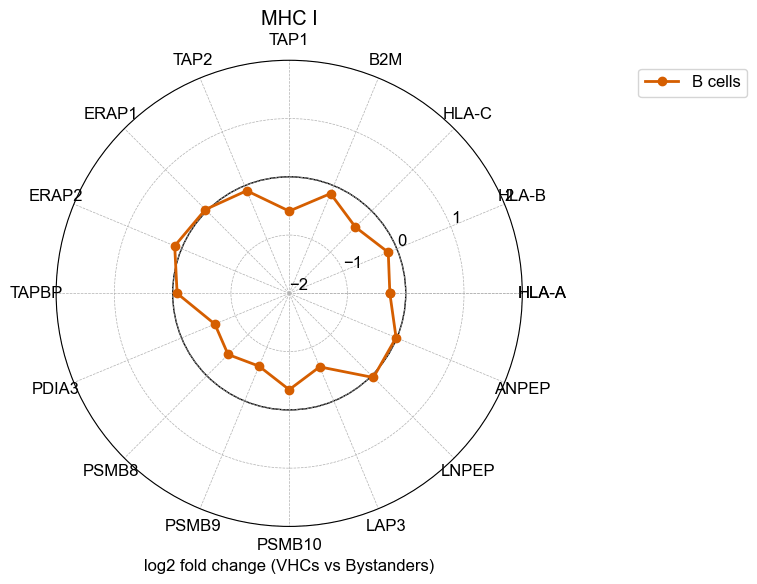

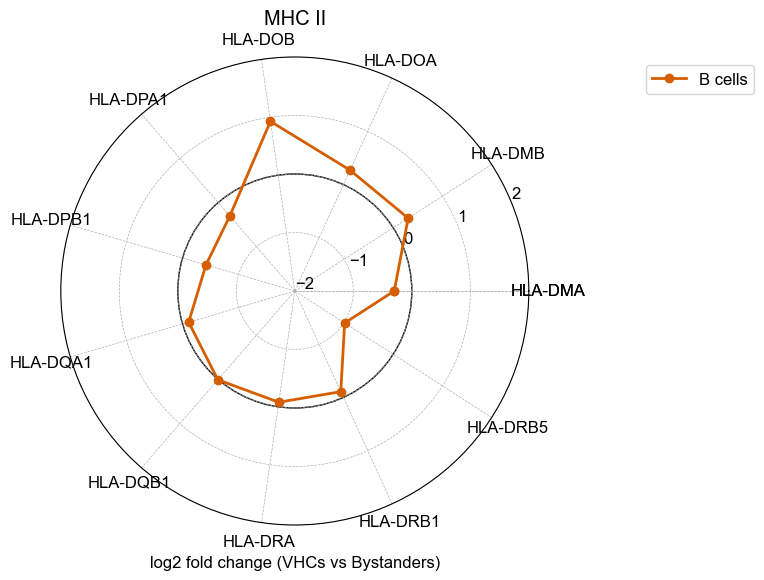

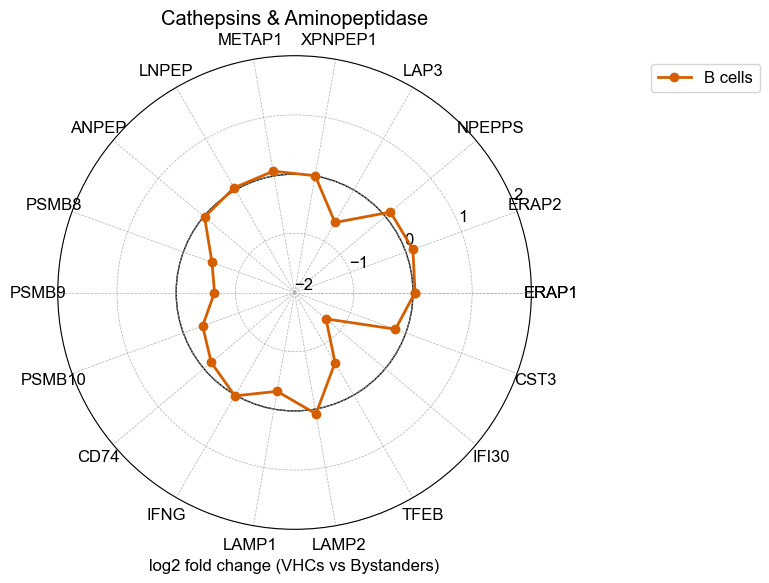

In [52]:
heatmap_df = pd.read_csv(save_tables + 'boostrap_VHC_vs_bystanders_replacement.tsv', sep='\t', index_col=0)
cts = ['B cells']
for gs, name in zip([ag_gs1, ag_gs2, m_fig], ['MHC_I', 'MHC_II', 'Cathepsins & Aminopeptidase']): 
    fig = radar_plot(cts, gs, heatmap_df, name)['fig']
    fig.savefig(save_figures + 'radar_{}.pdf'.format(name), bbox_inches='tight', dpi=300)

#### cst subpopulations

In [30]:
ct_csts = {
#  'B cells': ['naive B cells', 'memory B cells', 'activated B cells'],
#  'NK cells': ['cytotoxic NK cells', 'signaling NK cells'],
'Monocytes': ['classical monocytes', 'intermediate monocytes', 'non-classical monocytes', ],
}

g_ls = [
 'HLA-DMA',
 'HLA-DMB',
 'HLA-DOA',
 'HLA-DOB',
 'HLA-DPA1',
 'HLA-DPB1',
 'HLA-DQA1',
 'HLA-DQB1',
 'HLA-DRA',
 'HLA-DRB1',
 'HLA-DRB5',
 'CD163',
]

In [31]:
genelist = g_ls

for ct, csts in ct_csts.items():
    dic_list = []
    for cst in csts:
        adata_temp = temp[temp.obs['cell_subtype_new'] == cst]
        adata_temp = pre_processing_2(adata_temp)
        adata_temp = adata_temp[:, genelist]
        dic_n_1, dic_n_2, df_n = bootstrap_2(adata_temp, 100, 2)
 
        dic_list.append(dic_n_1)
        
    df_list = bar_plot_other_celltype(dic_list, np.unique(genelist))

    heatmap_df = pd.DataFrame(columns=csts, index=df_list[0].index)
    for col, df in zip(csts, df_list):
        heatmap_df[col] = df.median(axis=1)

    heatmap_df.to_csv(save_tables + 'boostrap_VHC_vs_bystanders_{}_cst.tsv'.format(ct), sep='\t')

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
Trying to set attribute `.obs` of view, copying.
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureW

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
Trying to set attribute `.obs` of view, copying.
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureW

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  df_sub[k].cat.remove_unused_categories(inplace=True)
/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1095: FutureWarning: The `inplace` parameter in pandas.Categor

In [32]:
def heatmap_virus(df, cell_type, path, filetype=False):
    rcParams['figure.figsize']=(7, df.shape[0])
    rcParams['font.size']=18
    rcParams['pdf.fonttype'] = 42
    rcParams['font.sans-serif'] = "Arial"
    rcParams['figure.dpi'] = 300

    fig, ax = plt.subplots()
    cmap = sns.diverging_palette(245, 5, as_cmap=True)
    ax = sns.heatmap(df, cmap=cmap, center=0, yticklabels=True,
                     cbar_kws={'label': 'log2 fold change\n(VHCs vs Bystanders)', 'shrink': .3})
    
    xlabels = []
    for label in ax.get_xticklabels():
        if label.get_text() in ['cDC1', 'cDC2', 'MAIT', 'Tregs']:
            xlabels.append(label)
        else:
            xlabels.append(label.get_text()[: - (len(cell_type) + 1)].replace(' ', '\n').capitalize())
    ax.set_xticklabels(xlabels, ha='left', va='bottom', rotation=45)
    
    ax.xaxis.tick_top() # x axis on top
    ax.xaxis.set_label_position('top')
    
    if filetype is not False:
        plt.savefig(os.path.join(path, 'VHCs_bystanders_' + filetype),bbox_inches='tight')

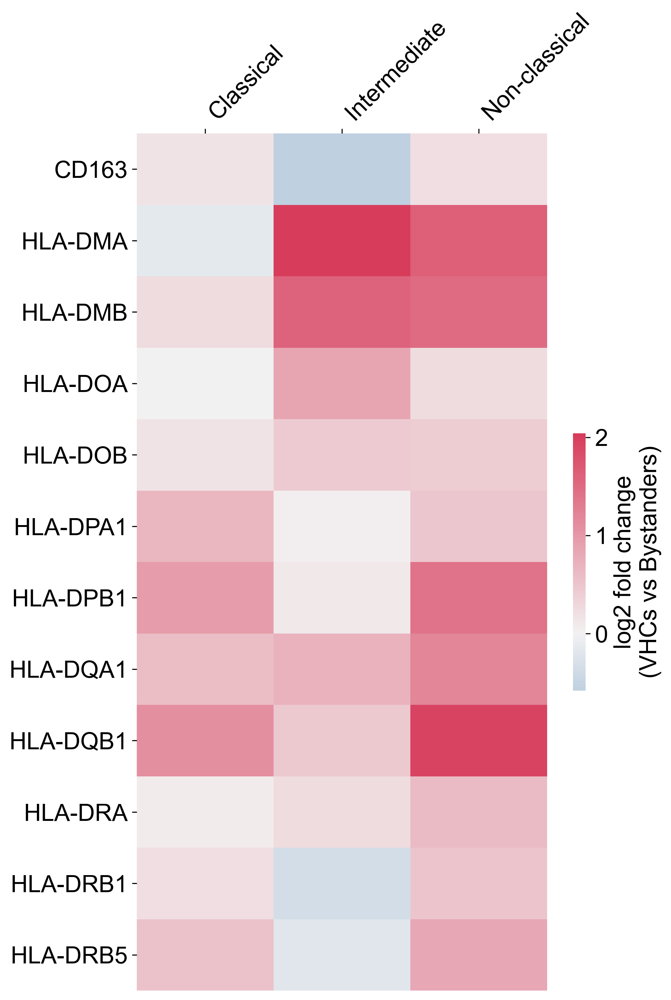

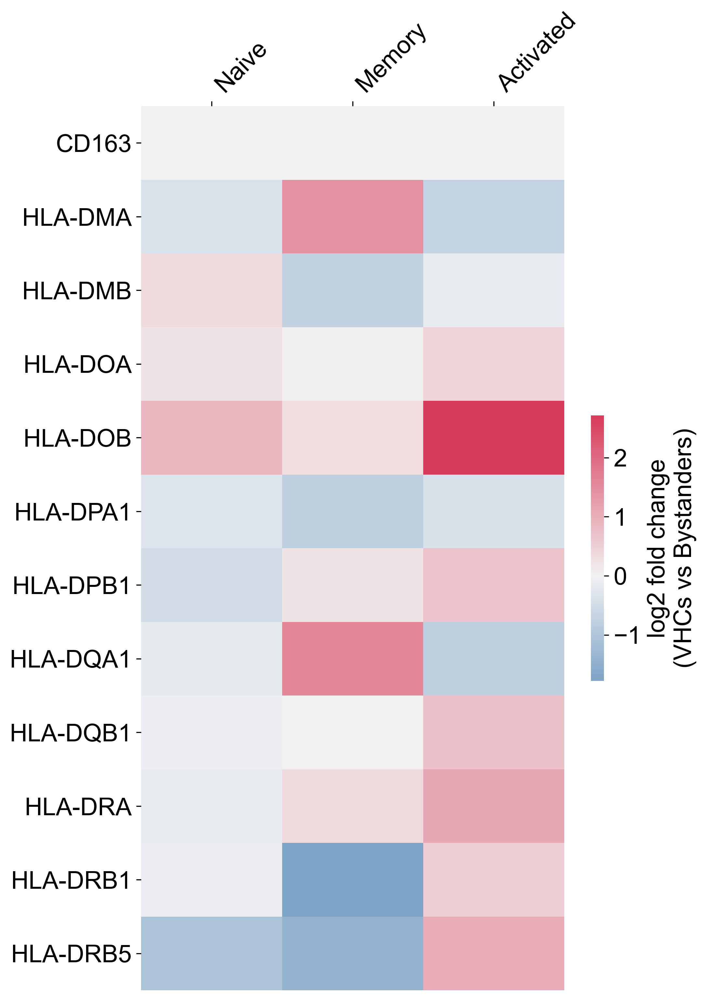

In [33]:
for ct in ['Monocytes', 'B cells']:
    df = pd.read_csv(save_tables + 'boostrap_VHC_vs_bystanders_{}_cst.tsv'.format(ct), sep='\t', index_col=0)
    heatmap_virus(df, ct, save_figures, '{}.pdf'.format(ct))

#### check log2foldchange

In [15]:
# VHCs vs bystanders
heatmap_df = pd.read_csv(save_tables + 'boostrap_VHC_vs_bystanders.tsv', sep='\t', index_col=0)

# SDp vs D
ct_pair = pd.read_csv('/home/yike/phd/dengue/docs/paper_draft/tabels/exclude_1_075_01/' + 
                      'ct_pairwise_SD_vs_D.tsv', sep='\t', index_col=['cell_subtype', 'gene'])
# ct_log2FC = pd.read_csv(save_tables + 'ct_log2FC.tsv', sep=',', index_col=0)

# cst_pair = pd.read_csv(save_tables + 'cst_pairwise_SD_vs_D.tsv', sep='\t', index_col=['cell_subtype', 'gene'])
# cst_log2FC = pd.read_csv(save_tables + 'cst_log2FC.tsv', sep=',', index_col=0)

In [59]:
threshold = 0.5
DEGs_df = pd.DataFrame([], columns=['log2foldchange(VHCvsby)'])

for ct in ['B cells', 'Monocytes', 'NK cells']:
    up = heatmap_df[heatmap_df[ct] > threshold]
    print('Upregulated in {}: {}'.format(ct, ' '.join(up.index.tolist())))
    DEGs[ct, 'up'] = up.index

    down = heatmap_df[heatmap_df[ct] < -threshold]
    print('Downregulated in {}: {}'.format(ct, ' '.join(down.index.tolist())))
    DEGs[ct, 'down'] = down.index

Upregulated in B cells: HLA-DOB
Downregulated in B cells: CTSZ HLA-DRB5 IFI30 LAP3 PSMB8 PSMB9 TAP1 TFEB
Upregulated in Monocytes: CTSL HLA-DMA HLA-DMB HLA-DPA1 HLA-DPB1 HLA-DQA1 HLA-DQB1 HLA-DRB5 LAP3 PSMB8
Downregulated in Monocytes: LAMP2
Upregulated in NK cells: HLA-DMA HLA-DPA1 HLA-DPB1 HLA-DQA1 HLA-DQB1 HLA-DRA HLA-DRB1 HLA-DRB5 LNPEP
Downregulated in NK cells: 


In [66]:
# filter VHCs vs bystanders 
threshold = 0.5
DEGs_df = pd.DataFrame([], columns=['log2foldchange(VHCvsby)'])

for ct in ['B cells', 'Monocytes', 'NK cells']:
    dfi = heatmap_df[(heatmap_df[ct] > threshold) | (heatmap_df[ct] < -threshold)][[ct]]
    dfi.columns = ['log2foldchange(VHCvsby)']
    dfi['celltype'] = ct
    
    DEGs_df = pd.concat([DEGs_df, dfi])

# add the log2 fold change of SDp vs D
DEGs_df = DEGs_df.reset_index().set_index(['celltype', 'index'])
DEGs_df['log2foldchange(SDpvsD)'] = ct_pair.loc[DEGs_df.index]['med_pair']

In [83]:
DEGs_df.to_csv(save_tables + 'DEGs_VHCbsVy_SDpvsD.tsv', sep='\t')

In [84]:
DEGs_df[(abs(DEGs_df['log2foldchange(VHCvsby)']) > threshold) &
        (abs(abs(DEGs_df['log2foldchange(SDpvsD)']) > threshold))]

log2foldchange(VHCvsby)  log2foldchange(SDpvsD)
celltype  index                                                   
B cells   HLA-DOB                 0.947854               -0.721904
          HLA-DRB5               -0.996808               -0.612966
          TAP1                   -0.593107                0.758767
Monocytes CTSL                    0.566568               -0.646344
          HLA-DPA1                0.700771               -1.301194
          HLA-DPB1                1.285172               -1.240249
          HLA-DQA1                0.898164               -1.927684
          HLA-DQB1                1.457072               -1.791691
          HLA-DRB5                0.576694               -1.773679
          LAP3                    0.611855                1.172450
NK cells  HLA-DPA1                0.885329                1.797273
          HLA-DPB1                0.754189                1.427190
          HLA-DRA                 0.814987                0.581571
          HLA-DRB1                0.892894                3.070198
          HLA-DRB5                0.900162                0.972741

In [73]:
# DEGs in Fig. 2
heatmap2 = pd.read_csv('/home/yike/phd/dengue/docs/paper_draft/tabels/' + 
                       'figure2_VHC_vs_bystanders.tsv', sep='\t', index_col=0)

In [76]:
# filter VHCs vs bystanders 
threshold = 0.5
DEGs_df2 = pd.DataFrame([], columns=['log2foldchange(VHCvsby)'])

for ct in ['B cells', 'Monocytes', 'NK cells']:
    dfi = heatmap2[(heatmap2[ct] > threshold) | (heatmap2[ct] < -threshold)][[ct]]
    dfi.columns = ['log2foldchange(VHCvsby)']
    dfi['celltype'] = ct
    
    DEGs_df2 = pd.concat([DEGs_df2, dfi])

# add the log2 fold change of SDp vs D
DEGs_df2 = DEGs_df2.reset_index().set_index(['celltype', 'index'])
DEGs_df2['log2foldchange(SDpvsD)'] = ct_pair.loc[DEGs_df2.index]['med_pair']

In [85]:
DEGs_df2.to_csv(save_tables + 'Fig2_DEGs_VHCbsVy_SDpvsD.tsv',
                                                                         sep='\t')

In [78]:
DEGs_df2[(abs(DEGs_df2['log2foldchange(VHCvsby)']) > threshold) &
        (abs(abs(DEGs_df2['log2foldchange(SDpvsD)']) > threshold))]

log2foldchange(VHCvsby)  log2foldchange(SDpvsD)
celltype  index                                                   
B cells   MT-CO3                  1.113833               -0.894640
          MT-ND4                  1.302545               -0.539432
          MT-ND4L                 1.505095               -1.374889
          FCER2                    1.35808               -0.908362
          TCL1A                   2.057288               -1.536215
          FCRLA                  -1.324169               -0.536994
          TXNIP                   1.593825                0.912083
          LTB                     2.000042               -1.263861
          LY6E                   -0.768992               -0.671223
          HLA-DRB5               -0.989762               -0.612966
          TCEA1                  -0.560809                1.134179
Monocytes MT-ND4                  1.389017                0.597491
          MT-ND4L                 1.285514                0.500465
          SYK                     0.538582                0.595699
          TNFRSF1B                0.658466               -0.621614
          HLA-DRB5                0.607938               -1.773679
          HLA-DPA1                0.667354               -1.301194
          TCEA1                    1.68532                0.546849
          HNRNPM                  1.413566                0.626122
NK cells  MT-CO3                  1.371074               -1.011708
          MT-ND4L                 1.666473               -0.866033
          HLA-DRB5                 0.93868                0.972741
          HLA-DPA1                0.944356                1.797273
          HNRNPM                  0.582591                1.028841
          WIPF1                   1.757361                0.666032